<a href="https://colab.research.google.com/github/nalymugwe/Macro_Economics_Factors_Housing/blob/main/Macro_economics_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Macro Economics Factors Analysis**

Macroeconomic factors are broad economic indicators that influence the overall health and performance of a country's economy. The macro ecomonic factors used in this analysis include: 

- Repo Rate: The interest rate at which the central bank lends money to commercial banks in exchange for collateral such as government securities (aka repurchase agreement).

- Reverse Repo Rate: The interest rate at which the central bank borrows money from commercial banks.

- Interbank Rate: The interest rate at which banks lend and borrow money from each other.

- Cash Reserve Requirement: The percentage of deposits that commercial banks are required to hold as reserves with the central bank.

- Central Bank Rate: The rate at which the central bank offers loans to commercial banks, and it serves as a benchmark for other interest rates in the economy.

- North America Diaspora Remittances  (USD '000): Money received from North America in USD starting from January 2004.

- Europe Diaspora Remittances  (USD '000): Money received from Europe in USD starting from January 2004.

- Rest of World Diaspora Remittances  (USD '000): Money received from the rest of the world in USD starting from January 2004

- Not Allocated (USD '000): Money received from diaspora that wasn't initially broken down starting from January 2004.

- Commercial Banks Weighted Average Deposit Rate: The average interest rate on commercial banks deposits starting from July 1991.

- Commercial Banks Weighted Average Savings Rate: The average interest rate on commercial banks savings starting from July 1991.

- Commercial Banks Weighted Average Lending Rate: The average interest rate on commercial banks loans starting from July 1991.

- Commercial Banks Weighted Average Overdraft Rate: The average interest rate on commercial banks overdraft starting  from July 1991.

- Treasury Bills* (shillings million): It falls under government debt starting consistently from January 2000. Its short-term debt instruments issued by the government to finance its short-term funding needs.

- Treasury Bonds (shillings million): It falls under government debt starting consistently from January 2000. Its long-term debt instruments issued by the government to finance its long-term funding needs.

- Government Stocks (shillings million): It falls under government debt starting consistently from January 2000. Similar to Treasury Bonds, but the interest rate paid on Government Stocks is usually linked to the prevailing market interest rates.

- Overdraft at Central Bank (shillings million): It falls under government debt starting consistently from January 2000. Short-term loans used to meet the government's immediate funding needs.

- Advances from Commercial Banks (shillings million): It falls under government debt starting consistently from January 2000. Amount of money that the government has borrowed from commercial banks.

- Other Domestic Debt** (shillings million): It falls under government debt starting consistently from January 2000

- External Debt (shillings million): It falls under government debt starting consistently from January 2000.

- Government loan from foreign sources.

- Average Annual Inflation Rate: The average rate at which prices of goods and services in an economy increase over a year starting from January 2015. The Kenya National Bureau of statistics (KNBS) revised the inflation basket in February 2020 with the base period changing from February 2009 to February 2019. The previous CPI basket of 234 items was revised to 330 items. The new CPI basket included commodities that had recently entered into the market, while obsolete ones were removed. Some of the new items included in the basket are mobile money transfer, mobile phone airtime, private TV subscription charges, courier services, garbage and refuse collection. Other items including kerosene stove, radio/cassette/cd player, video cassette hire etc were among the items in the old baskets that were dropped.

- Nairobi Upper Income Inflation Rate: A breakdown of the inflation rate as per the income group starting from January 2015.

- Nairobi Middle Income Inflation Rate: A breakdown of the inflation rate as per the income group starting from January 2015.

- Nairobi Lower Income Inflation Rate: A breakdown of the inflation rate as per the income group starting from January 2015.

- Rest of Kenya Inflation Rate: A breakdown of the inflation rate as per the income group starting from January 2015.

- Consumer Price Index: A measure of the price of a basket of goods and services that are typically purchased by households starting from July 1991.

- Real Estate Growth (shillings million - Annual): Growth rate of the real estate.

- Nominal Annual GDP (Shiilings million): Annual Growth of the country's GDP.

- Annual GDP Rate: The percentage change in a country's GDP from one year to the next


Exploratory Data Analysis (EDA) of macroeconomic factors can help with real estate analysis in several ways:

1. Identify Trends: EDA can reveal long-term trends in macroeconomic factors, such as GDP growth or inflation. Understanding these trends can provide insights into the overall economic conditions and the potential impact on real estate markets.

2. Understand Relationships: EDA can help identify correlations or relationships between macroeconomic factors and real estate indicators, such as housing prices or housing demand. This can assist in understanding how changes in macroeconomic variables influence the real estate market.

3. Forecast and Predictive Analysis: By analyzing historical data and trends, EDA can help build predictive models to forecast real estate market performance based on macroeconomic factors. These models can aid in making informed investment decisions or assessing market risks.

4. Risk Assessment: EDA can assist in assessing the risk associated with real estate investments by analyzing macroeconomic factors. Understanding how factors impact the real estate market can help in evaluating investment opportunities and potential risks.



## **1. Load Data**

In [1]:
#Install toad library for intuitive functions

!pip -q install toad

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 13.3 MB/s eta 0:00:00


In [2]:
# Import libraries
import pandas as pd
import toad
import datetime as dt
import calendar
import re
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from scipy import stats
import itertools
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler



In [3]:
# Create a datasets directory on google colab to host the files
!rm -rf datasets
!mkdir -p datasets
!cd datasets

# Fetch the files from Github
!wget -q --show-progress "https://raw.githubusercontent.com/nalymugwe/Macro_Economics_Factors_Housing/main/Macro-Economic_Factors_Data.csv" -P ./datasets

Macro-Economic_Fact 100%[===================>]  58.43K  --.-KB/s    in 0.007s  


In [4]:
# Load the Macro Economics data

df = pd.read_csv('/content/datasets/Macro-Economic_Factors_Data.csv')
df.head()

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30
0,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),...,External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate
1,1991,July,-,-,NaN,-,-,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.13,NaN,NaN,NaN
2,1991,August,-,-,NaN,-,-,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.16,NaN,NaN,NaN
3,1991,September,-,-,NaN,-,-,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.34,NaN,NaN,NaN
4,1991,October,-,-,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.35,NaN,NaN,NaN


In [5]:
# Show all columns
pd.set_option('display.max_columns', None)  # Show all columns


In [6]:
# Store the first row as the new header
new_header = df.iloc[0]  

# Remove the first row (current header)
df = df[1:]  

# Set the new header
df.columns = new_header  

df.head()


,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate
1,1991,July,-,-,NaN,-,-,NaN,NaN,NaN,NaN,13.5,12.97,16.71,16.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.13,NaN,NaN,NaN
2,1991,August,-,-,NaN,-,-,NaN,NaN,NaN,NaN,13.59,13.24,16.42,13.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.16,NaN,NaN,NaN
3,1991,September,-,-,NaN,-,-,NaN,NaN,NaN,NaN,13.49,13.1,17.26,16.95,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.34,NaN,NaN,NaN
4,1991,October,-,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.47,13.3,17.78,17.53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.35,NaN,NaN,NaN
5,1991,November,-,-,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.7,13.37,17.94,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.4,NaN,NaN,NaN


## **2. Data Cleaning**

In [7]:
#Obtain the shape of the dataframe
print("The shape of the dataset: ", df.shape)

The shape of the dataset:  (381, 31)


In [8]:
#View the column names of the dataset
df.columns

Index(['Year', 'Month', 'Repo Rate', 'Reverse Repo Rate', 'Interbank Rate',
       'Cash Reserve Requirement Rate', 'Central Bank Rate',
       'North America Diaspora Remittances  (USD '000)',
       'Europe Diaspora Remittances  (USD '000)',
       'Rest of World Diaspora Remittances  (USD '000)',
       'Not Allocated (USD '000)',
       'Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate',
       'Treasury Bills* (shillings million)',
       'Treasury Bonds (shillings million)',
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)',
       'External Debt (shillings million)', 'Average Annual Inflation Rate',
       'Nairobi Upper Income Inflation Rate',
   

In [9]:
# Data quality report
toad.detect(df)

,type,size,missing,unique,mean_or_top1,std_or_top2,min_or_top3,1%_or_top4,10%_or_top5,50%_or_bottom5,75%_or_bottom4,90%_or_bottom3,99%_or_bottom2,max_or_bottom1
Year,object,381,0.00%,33,2007:3.15%,1992:3.15%,2020:3.15%,2019:3.15%,2018:3.15%,1994:3.15%,1993:3.15%,2021:3.15%,1991:1.57%,2023:0.79%
Month,object,381,0.00%,13,July:8.40%,August:8.40%,September:8.40%,October:8.40%,November:8.40%,January:8.14%,April:8.14%,May:8.14%,June:8.14%,January :0.26%
Repo Rate,object,381,1.57%,228,-:30.45%,7.23:0.79%,8.39:0.79%,11.5:0.79%,6.23:0.52%,4.95:0.26%,8.97:0.26%,7.25:0.26%,7.28:0.26%,7.65:0.26%
Reverse Repo Rate,object,381,4.72%,86,-:69.29%,1.84:0.79%,10.02:0.79%,10.1:0.79%,10.01:0.79%,18.12:0.26%,11.28:0.26%,12.35:0.26%,8.61:0.26%,9.84:0.26%
Interbank Rate,object,381,30.18%,240,4.73:0.79%,2.95:0.79%,5.12:0.79%,7.79:0.52%,6.41:0.52%,7.72:0.26%,8.07:0.26%,6.92:0.26%,6.7:0.26%,6.42:0.26%
Cash Reserve Requirement Rate,object,381,29.40%,8,5.25:25.98%,6:17.32%,4.25:9.45%,10:7.61%,4.5:6.30%,10:7.61%,4.5:6.30%,5:1.57%,4.75:1.57%,-:0.79%
Central Bank Rate,object,381,46.46%,23,8.5:8.40%,10:7.87%,7:7.87%,9:5.77%,8.75:3.67%,9.75:0.52%,5.75:0.52%,13:0.52%,8:0.52%,7.25:0.26%
North America Diaspora Remittances (USD '000),object,381,39.37%,194,0:9.97%,"116,998.61:0.26%","77,297.81:0.26%","76,199.74:0.26%","73,485.90:0.26%","42,985.08:0.26%","44,472.75:0.26%","49,555.26:0.26%","52,088.43:0.26%","212,079.84:0.26%"
Europe Diaspora Remittances (USD '000),object,381,39.37%,194,0:9.97%,"43,704.82:0.26%","55,441.04:0.26%","54,972.83:0.26%","54,511.54:0.26%","26,264.37:0.26%","25,402.20:0.26%","25,197.08:0.26%","29,305.28:0.26%","66,569.69:0.26%"
Rest of World Diaspora Remittances (USD '000),object,381,39.37%,194,0:9.97%,"61,222.54:0.26%","28,761.94:0.26%","23,703.49:0.26%","24,311.83:0.26%","23,269.11:0.26%","21,752.17:0.26%","22,751.88:0.26%","24,262.71:0.26%","78,330.94:0.26%"


## **Changes to be made from data inspection**

- Change all the data saved as object to numerical data except for the month variable.

- Convert the USD rates to KES.

- Check missing values percentage per row

In [10]:
# Define a function to remove commas from the values

def removing_commas(value):
    if isinstance(value, str):
        value = re.sub(',', '', value)
        if value == '-':
            return np.nan
        return float(value)
    return value

In [11]:
# Specify the columns to exclude from data type conversion

excluding_columns = ['Month']

for column in df.columns:
    if column not in excluding_columns:
        df[column] = df[column].apply(removing_commas).astype(float)

df.dtypes

0
Year                                                  float64
Month                                                  object
Repo Rate                                             float64
Reverse Repo Rate                                     float64
Interbank Rate                                        float64
Cash Reserve Requirement Rate                         float64
Central Bank Rate                                     float64
North America Diaspora Remittances  (USD '000)        float64
Europe Diaspora Remittances  (USD '000)               float64
Rest of World Diaspora Remittances  (USD '000)        float64
Not Allocated (USD '000)                              float64
Commercial Banks Weighted Average Deposit Rate        float64
Commercial Banks Weighted Average Savings Rate        float64
Commercial Banks Weighted Average Lending Rate        float64
Commercial Banks Weighted Average Overdraft Rate      float64
Treasury Bills* (shillings million)                   float64
Treasu

In [12]:
# Convert the year column to int and then to datetime year format
df['Year'] = pd.to_datetime(df['Year'].astype(int), format='%Y').dt.year
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381 entries, 1 to 381
Data columns (total 31 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Year                                                381 non-null    int64  
 1   Month                                               381 non-null    object 
 2   Repo Rate                                           259 non-null    float64
 3   Reverse Repo Rate                                   99 non-null     float64
 4   Interbank Rate                                      266 non-null    float64
 5   Cash Reserve Requirement Rate                       266 non-null    float64
 6   Central Bank Rate                                   201 non-null    float64
 7   North America Diaspora Remittances  (USD '000)      231 non-null    float64
 8   Europe Diaspora Remittances  (USD '000)             231 non-null    float64
 9  

In [13]:
# Inspect the data

df.tail()

,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate
377,2022,November,7.65,9.70,4.61,4.25,8.75,200404.95,67185.24,77858.47,0.0,7.11,3.50,12.64,12.16,705967.70,3673801.94,0.0,41701.92,13824.18,641.43,4462891.060,7.38,6.90,7.78,10.36,9.68,128.31,NaN,NaN,NaN
378,2022,December,NaN,9.84,5.39,4.25,8.75,206211.25,67802.06,83285.37,0.0,7.17,3.56,12.67,12.22,689244.30,3710621.74,0.0,58498.05,13827.53,646.90,4673144.127,7.66,6.86,7.49,9.23,9.50,128.99,NaN,NaN,NaN
379,2023,January,NaN,10.01,5.89,4.25,8.75,212010.98,59838.87,77541.98,0.0,7.47,3.60,12.77,12.34,676659.60,3744037.59,0.0,65998.59,14370.13,648.23,4681115.475,NaN,7.05,7.69,9.11,9.35,129.29,NaN,NaN,NaN
380,2023,February,NaN,10.10,6.42,4.25,8.75,189034.56,56820.89,63317.25,0.0,7.54,3.58,13.06,12.62,693142.45,3773447.09,0.0,68726.10,15599.72,645.91,NaN,NaN,NaN,NaN,NaN,NaN,130.13,NaN,NaN,NaN
381,2023,March,NaN,NaN,NaN,NaN,NaN,212079.84,66569.69,78330.94,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,131.18,NaN,NaN,NaN


In [14]:
 # Create a datasets directory on google colab to host the files
!rm -rf datasets
!mkdir -p datasets
!cd datasets

# Fetch the files from Github
!wget -q --show-progress "https://raw.githubusercontent.com/nalymugwe/Macro_Economics_Factors_Housing/main/Monthly_USD_Rates.csv" -P ./datasets

Monthly_USD_Rates.c 100%[===================>]   5.12K  --.-KB/s    in 0s      


In [15]:
# Load the Exchange Rate data

USD_Rate = pd.read_csv('/content/datasets/Monthly_USD_Rates.csv')
USD_Rate.head()

,Year,Month,Dollar Rate
0,1993,1,36.23
1,1993,2,36.56
2,1993,3,43.12
3,1993,4,51.88
4,1993,5,62.16


In [16]:
# Inspect the data
USD_Rate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 363 entries, 0 to 362
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Year         363 non-null    int64  
 1   Month        363 non-null    int64  
 2   Dollar Rate  363 non-null    float64
dtypes: float64(1), int64(2)
memory usage: 8.6 KB


In [17]:
# Convert the 'Year' column to year date format
USD_Rate['Year'] = pd.to_datetime(USD_Rate['Year'], format='%Y').dt.year
USD_Rate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 363 entries, 0 to 362
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Year         363 non-null    int64  
 1   Month        363 non-null    int64  
 2   Dollar Rate  363 non-null    float64
dtypes: float64(1), int64(2)
memory usage: 8.6 KB


In [18]:
# Define a dictionary to map integer month values to month names
month_names = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

# Apply the mapping to convert integer month values to month names
USD_Rate['Month'] = USD_Rate['Month'].map(month_names)

# Print the updated DataFrame
USD_Rate.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 363 entries, 0 to 362
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Year         363 non-null    int64  
 1   Month        363 non-null    object 
 2   Dollar Rate  363 non-null    float64
dtypes: float64(1), int64(1), object(1)
memory usage: 8.6+ KB


In [19]:
# Merge the datasets (Macro economics and exchange rate datasets)
merged_df = pd.merge(df, USD_Rate, on=['Year', 'Month'], how='left')
merged_df.head()


,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate,Dollar Rate
0,1991,July,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.50,12.97,16.71,16.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.13,NaN,NaN,NaN,NaN
1,1991,August,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.59,13.24,16.42,13.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.16,NaN,NaN,NaN,NaN
2,1991,September,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.49,13.10,17.26,16.95,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.34,NaN,NaN,NaN,NaN
3,1991,October,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.47,13.30,17.78,17.53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.35,NaN,NaN,NaN,NaN
4,1991,November,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.70,13.37,17.94,18.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.40,NaN,NaN,NaN,NaN


In [20]:
# Check the last 5 rows
merged_df.tail()

,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate,Dollar Rate
376,2022,November,7.65,9.70,4.61,4.25,8.75,200404.95,67185.24,77858.47,0.0,7.11,3.50,12.64,12.16,705967.70,3673801.94,0.0,41701.92,13824.18,641.43,4462891.060,7.38,6.90,7.78,10.36,9.68,128.31,NaN,NaN,NaN,121.90
377,2022,December,NaN,9.84,5.39,4.25,8.75,206211.25,67802.06,83285.37,0.0,7.17,3.56,12.67,12.22,689244.30,3710621.74,0.0,58498.05,13827.53,646.90,4673144.127,7.66,6.86,7.49,9.23,9.50,128.99,NaN,NaN,NaN,122.93
378,2023,January,NaN,10.01,5.89,4.25,8.75,212010.98,59838.87,77541.98,0.0,7.47,3.60,12.77,12.34,676659.60,3744037.59,0.0,65998.59,14370.13,648.23,4681115.475,NaN,7.05,7.69,9.11,9.35,129.29,NaN,NaN,NaN,NaN
379,2023,February,NaN,10.10,6.42,4.25,8.75,189034.56,56820.89,63317.25,0.0,7.54,3.58,13.06,12.62,693142.45,3773447.09,0.0,68726.10,15599.72,645.91,NaN,NaN,NaN,NaN,NaN,NaN,130.13,NaN,NaN,NaN,125.45
380,2023,March,NaN,NaN,NaN,NaN,NaN,212079.84,66569.69,78330.94,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,131.18,NaN,NaN,NaN,129.74


In [21]:
# Merge the 'year' and 'month' columns into 'month_year' as datetime objects
merged_df['Month_Year'] = pd.to_datetime(merged_df['Month'] + ' ' + merged_df['Year'].astype(str), format='%B %Y')

# Move the merged column to the third position
merged_df.insert(2, 'Month_Year', merged_df.pop('Month_Year'))

# Inspect the data
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 381 entries, 0 to 380
Data columns (total 33 columns):
 #   Column                                              Non-Null Count  Dtype         
---  ------                                              --------------  -----         
 0   Year                                                381 non-null    int64         
 1   Month                                               381 non-null    object        
 2   Month_Year                                          381 non-null    datetime64[ns]
 3   Repo Rate                                           259 non-null    float64       
 4   Reverse Repo Rate                                   99 non-null     float64       
 5   Interbank Rate                                      266 non-null    float64       
 6   Cash Reserve Requirement Rate                       266 non-null    float64       
 7   Central Bank Rate                                   201 non-null    float64       
 8   North Amer

In [22]:
# Check NaN values from 'USD RATE' column in the merged dataset
nan_values = merged_df[merged_df['Dollar Rate'].isna()]

# Print all the selected NaN values
nan_values.head(len(nan_values))

,Year,Month,Month_Year,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate,Dollar Rate
0,1991,July,1991-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.50,12.97,16.71,16.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.13,NaN,NaN,NaN,NaN
1,1991,August,1991-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.59,13.24,16.42,13.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.16,NaN,NaN,NaN,NaN
2,1991,September,1991-09-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.49,13.10,17.26,16.95,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.34,NaN,NaN,NaN,NaN
3,1991,October,1991-10-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.47,13.30,17.78,17.53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.35,NaN,NaN,NaN,NaN
4,1991,November,1991-11-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.70,13.37,17.94,18.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.40,NaN,NaN,NaN,NaN
5,1991,December,1991-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.73,13.22,17.87,17.91,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.44,NaN,NaN,NaN,NaN
6,1992,January,1992-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.71,13.18,17.13,15.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.57,NaN,NaN,NaN,NaN
7,1992,February,1992-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.83,13.30,17.61,16.37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.64,NaN,NaN,NaN,NaN
8,1992,March,1992-03-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.85,13.45,18.12,18.47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.31,NaN,NaN,NaN,NaN
9,1992,April,1992-04-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.76,13.38,17.37,15.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.38,NaN,NaN,NaN,NaN


In [23]:
# Check the USD Value from the USD Rate data that's missing from the merged dataset
value = USD_Rate.iloc[360, 2]
value

123.93

In [24]:
# Replace the null value from row 378 to its correct value in 'Dollar rate'
replacement_value = 123.93
merged_df.at[378, 'Dollar Rate'] = replacement_value

#Check the last 5 rows
merged_df.tail()



,Year,Month,Month_Year,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate,Dollar Rate
376,2022,November,2022-11-01,7.65,9.70,4.61,4.25,8.75,200404.95,67185.24,77858.47,0.0,7.11,3.50,12.64,12.16,705967.70,3673801.94,0.0,41701.92,13824.18,641.43,4462891.060,7.38,6.90,7.78,10.36,9.68,128.31,NaN,NaN,NaN,121.90
377,2022,December,2022-12-01,NaN,9.84,5.39,4.25,8.75,206211.25,67802.06,83285.37,0.0,7.17,3.56,12.67,12.22,689244.30,3710621.74,0.0,58498.05,13827.53,646.90,4673144.127,7.66,6.86,7.49,9.23,9.50,128.99,NaN,NaN,NaN,122.93
378,2023,January,2023-01-01,NaN,10.01,5.89,4.25,8.75,212010.98,59838.87,77541.98,0.0,7.47,3.60,12.77,12.34,676659.60,3744037.59,0.0,65998.59,14370.13,648.23,4681115.475,NaN,7.05,7.69,9.11,9.35,129.29,NaN,NaN,NaN,123.93
379,2023,February,2023-02-01,NaN,10.10,6.42,4.25,8.75,189034.56,56820.89,63317.25,0.0,7.54,3.58,13.06,12.62,693142.45,3773447.09,0.0,68726.10,15599.72,645.91,NaN,NaN,NaN,NaN,NaN,NaN,130.13,NaN,NaN,NaN,125.45
380,2023,March,2023-03-01,NaN,NaN,NaN,NaN,NaN,212079.84,66569.69,78330.94,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,131.18,NaN,NaN,NaN,129.74


In [25]:
# Check column names of the merged dataset

merged_df.columns

Index(['Year', 'Month', 'Month_Year', 'Repo Rate', 'Reverse Repo Rate',
       'Interbank Rate', 'Cash Reserve Requirement Rate', 'Central Bank Rate',
       'North America Diaspora Remittances  (USD '000)',
       'Europe Diaspora Remittances  (USD '000)',
       'Rest of World Diaspora Remittances  (USD '000)',
       'Not Allocated (USD '000)',
       'Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate',
       'Treasury Bills* (shillings million)',
       'Treasury Bonds (shillings million)',
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)',
       'External Debt (shillings million)', 'Average Annual Inflation Rate',
       'Nairobi Upper Income Inflat

In [26]:
# Extract the USD Columns to convert their rates
usd_columns = ["North America Diaspora Remittances  (USD '000)", "Europe Diaspora Remittances  (USD '000)", "Rest of World Diaspora Remittances  (USD '000)", "Not Allocated (USD '000)"] 

# Apply the conversion and divide by 1000 to get the value to the nearest million shillings
for column in usd_columns:
    merged_df[column] = merged_df[column] * merged_df['Dollar Rate'] / 1000

# Print the updated dataset
merged_df.tail(10)


,Year,Month,Month_Year,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (USD '000),Europe Diaspora Remittances (USD '000),Rest of World Diaspora Remittances (USD '000),Not Allocated (USD '000),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate,Dollar Rate
371,2022,June,2022-06-01,6.80,8.40,5.06,4.25,7.50,22603.745262,6944.466441,8695.341066,0.0,6.62,2.50,12.27,11.86,647043.70,3569092.01,0.0,58502.25,13054.41,640.60,4290775.570,6.29,5.71,6.25,8.19,8.32,124.22,NaN,NaN,NaN,117.29
372,2022,July,2022-07-01,7.24,8.59,5.50,4.25,7.50,22807.092247,6618.836182,8365.987164,0.0,6.74,2.94,12.35,12.02,665244.30,3585114.16,0.0,45439.46,14245.63,647.99,4299821.200,6.45,6.01,6.27,8.75,8.79,125.02,NaN,NaN,NaN,118.32
373,2022,August,2022-08-01,NaN,9.21,5.35,4.25,7.50,22273.478372,6538.740780,8277.845581,0.0,6.93,3.47,12.43,12.10,678260.55,3595250.31,0.0,49145.21,11974.22,643.15,4327930.650,6.61,6.20,6.47,9.19,8.88,125.58,NaN,NaN,NaN,119.45
374,2022,September,2022-09-01,NaN,9.63,4.36,4.25,8.25,23222.279297,6682.310514,8386.681005,0.0,6.82,3.44,12.41,11.99,690569.05,3634864.41,0.0,27247.35,12965.12,632.76,4334790.820,6.81,6.92,7.34,9.75,9.51,126.73,NaN,NaN,NaN,120.42
375,2022,October,2022-10-01,NaN,9.78,5.44,4.25,8.25,23995.730950,7621.579830,8640.815820,0.0,7.01,3.46,12.39,11.96,679456.30,3632708.90,0.0,59819.48,13452.05,657.61,4359569.490,7.48,7.07,7.88,10.17,9.92,127.76,NaN,NaN,NaN,121.03
376,2022,November,2022-11-01,7.65,9.70,4.61,4.25,8.75,24429.363405,8189.880756,9490.947493,0.0,7.11,3.50,12.64,12.16,705967.70,3673801.94,0.0,41701.92,13824.18,641.43,4462891.060,7.38,6.90,7.78,10.36,9.68,128.31,NaN,NaN,NaN,121.90
377,2022,December,2022-12-01,NaN,9.84,5.39,4.25,8.75,25349.548963,8334.907236,10238.270534,0.0,7.17,3.56,12.67,12.22,689244.30,3710621.74,0.0,58498.05,13827.53,646.90,4673144.127,7.66,6.86,7.49,9.23,9.50,128.99,NaN,NaN,NaN,122.93
378,2023,January,2023-01-01,NaN,10.01,5.89,4.25,8.75,26274.520751,7415.831159,9609.777581,0.0,7.47,3.60,12.77,12.34,676659.60,3744037.59,0.0,65998.59,14370.13,648.23,4681115.475,NaN,7.05,7.69,9.11,9.35,129.29,NaN,NaN,NaN,123.93
379,2023,February,2023-02-01,NaN,10.10,6.42,4.25,8.75,23714.385552,7128.180651,7943.149013,0.0,7.54,3.58,13.06,12.62,693142.45,3773447.09,0.0,68726.10,15599.72,645.91,NaN,NaN,NaN,NaN,NaN,NaN,130.13,NaN,NaN,NaN,125.45
380,2023,March,2023-03-01,NaN,NaN,NaN,NaN,NaN,27515.238442,8636.751581,10162.656156,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,131.18,NaN,NaN,NaN,129.74


In [27]:
# Rename the columns that had USD names to avoid confusion

# Define the new column names
updated_column_names = {"North America Diaspora Remittances  (USD '000)": "North America Diaspora Remittances (shillings million)", 
                        "Europe Diaspora Remittances  (USD '000)": "Europe Diaspora Remittances (shillings million)",  
                        "Rest of World Diaspora Remittances  (USD '000)": "Rest of World Diaspora Remittances (shillings million)", 
                        "Not Allocated (USD '000)": "Not Allocated (shillings million)"}
              
#Create a function to change the names
merged_df2 = merged_df.rename(columns=lambda x: updated_column_names[x] if x in updated_column_names else x) 

# display the columns after renaming
merged_df2.columns

Index(['Year', 'Month', 'Month_Year', 'Repo Rate', 'Reverse Repo Rate',
       'Interbank Rate', 'Cash Reserve Requirement Rate', 'Central Bank Rate',
       'North America Diaspora Remittances (shillings million)',
       'Europe Diaspora Remittances (shillings million)',
       'Rest of World Diaspora Remittances (shillings million)',
       'Not Allocated (shillings million)',
       'Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate',
       'Treasury Bills* (shillings million)',
       'Treasury Bonds (shillings million)',
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)',
       'External Debt (shillings million)', 'Average Annual Inflation Rate',
  

In [28]:
# Delete the dollar rate column as its no longer needed

merged_df2 = merged_df2.drop('Dollar Rate', axis=1)

In [29]:
# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Calculate the percentage of missing values per row
missing_percentages = merged_df2.isnull().mean(axis=1) * 100

# Create a new DataFrame to store the results
missing_df = pd.DataFrame({'MissingPercentage': missing_percentages})

# Filter and display rows with missing values
rows_with_missing = missing_df[missing_df['MissingPercentage'] > 0]
rows_with_missing = rows_with_missing.round(2)  # Round to 2 decimal points
print(rows_with_missing)

     MissingPercentage
0                75.00
1                75.00
2                75.00
3                75.00
4                75.00
5                75.00
6                75.00
7                75.00
8                75.00
9                75.00
10               75.00
11               75.00
12               75.00
13               75.00
14               75.00
15               75.00
16               75.00
17               75.00
18               75.00
19               75.00
20               75.00
21               75.00
22               75.00
23               75.00
24               75.00
25               75.00
26               75.00
27               75.00
28               75.00
29               75.00
30               75.00
31               75.00
32               75.00
33               75.00
34               75.00
35               75.00
36               75.00
37               75.00
38               75.00
39               75.00
40               75.00
41               75.00
42         

In [30]:
# Check the Year when the missing values in the row less than or equal to 50%

year_value = merged_df2.iloc[107, 0:2]
year_value

Year     2000
Month    June
Name: 107, dtype: object

In [31]:
# Replace missing values with zero
clean_merged = merged_df2.fillna(0)


In [32]:
# Inspect the data using the toad libary

toad.detect(clean_merged)

,type,size,missing,unique,mean_or_top1,std_or_top2,min_or_top3,1%_or_top4,10%_or_top5,50%_or_bottom5,75%_or_bottom4,90%_or_bottom3,99%_or_bottom2,max_or_bottom1
Year,int64,381,0.00%,33,2006.874016,9.184935,1991.0,1991.0,1994.0,2007.0,2015.0,2020.0,2022.0,2023.0
Month,object,381,0.00%,13,July:8.40%,August:8.40%,September:8.40%,October:8.40%,November:8.40%,January:8.14%,April:8.14%,May:8.14%,June:8.14%,January :0.26%
Month_Year,datetime64[ns],381,0.00%,381,1991-07-01 00:00:00:0.26%,2012-06-01 00:00:00:0.26%,2013-03-01 00:00:00:0.26%,2013-02-01 00:00:00:0.26%,2013-01-01 00:00:00:0.26%,2001-12-01 00:00:00:0.26%,2001-11-01 00:00:00:0.26%,2001-10-01 00:00:00:0.26%,2001-09-01 00:00:00:0.26%,2023-03-01 00:00:00:0.26%
Repo Rate,float64,381,0.00%,228,5.668215,5.330946,0.0,0.0,0.0,6.16,8.3,11.75,22.774,24.5
Reverse Repo Rate,float64,381,0.00%,86,2.026352,3.842681,0.0,0.0,0.0,0.0,1.23,9.64,12.014,18.12
Interbank Rate,float64,381,0.00%,241,4.600525,4.473792,0.0,0.0,0.0,4.63,7.18,9.14,19.386,28.9
Cash Reserve Requirement Rate,float64,381,0.00%,8,4.003281,2.955952,0.0,0.0,0.0,5.25,5.25,6.0,10.0,10.0
Central Bank Rate,float64,381,0.00%,23,4.787402,4.866245,0.0,0.0,0.0,6.0,8.75,10.0,18.0,18.0
North America Diaspora Remittances (shillings million),float64,381,0.00%,194,4291.443876,6597.51046,0.0,0.0,0.0,1281.661053,5651.488538,12631.798088,25367.59367,27515.238442
Europe Diaspora Remittances (shillings million),float64,381,0.00%,194,1893.228197,2475.865579,0.0,0.0,0.0,872.369368,3261.052962,5965.600979,8448.69386,9518.21349


###**Data Cleaning Notes**

- The values in the dataset were all uploaded as an object, this was changed to numerical values except for Month which was converted to the month format.

- A new column was created by merging the Month and Year that will be useful for trend analysis.

- Some of the values were saved in USD, these were converted to KES by uploading a dataset that had historical monthly exchange rates. On inspection after conversion, a particular row value was not successfully converted and this was changed by replacing the null value with the correct value from the exchange rate dataset.

- An analyis of missing values was done per row and noted that from June 2000, the row values had 50% missing values and this continued to decrease over the years as more of these columns were being populated with the correct values. The missing values was replaced with zero.


# **3. Exploratory Data Analysis**

### **3.1 Trend Analysis**

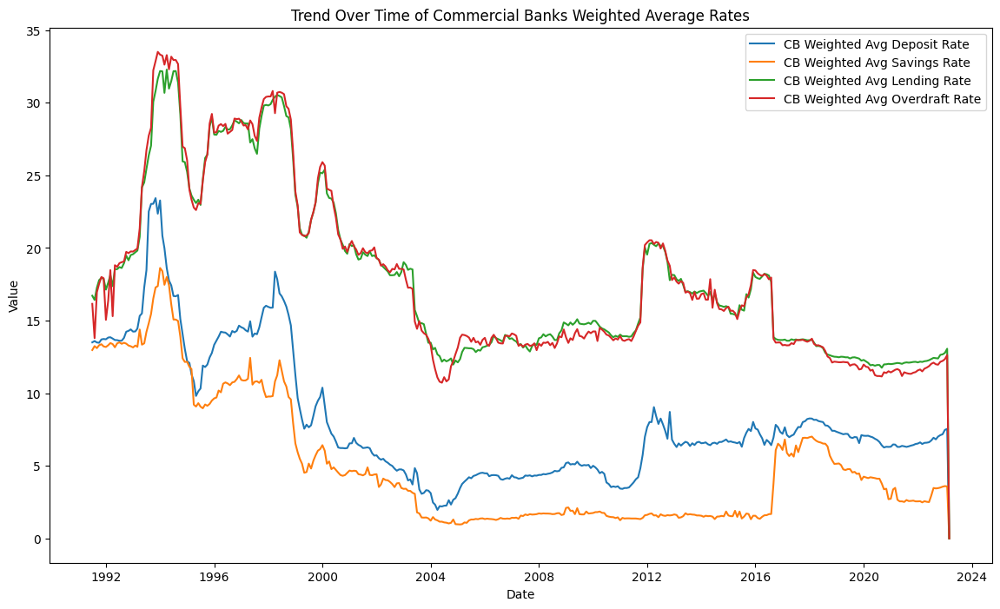

In [33]:
# Trend Analysis of the Commercial Bank rates

# Set the 'date' column as the index
clean_merged.set_index('Month_Year', inplace=True)

# Plot the line graph
plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Commercial Banks Weighted Average Deposit Rate'], label='CB Weighted Avg Deposit Rate')
plt.plot(clean_merged.index, clean_merged['Commercial Banks Weighted Average Savings Rate'], label='CB Weighted Avg Savings Rate')
plt.plot(clean_merged.index, clean_merged['Commercial Banks Weighted Average Lending Rate'], label='CB Weighted Avg Lending Rate')
plt.plot(clean_merged.index, clean_merged['Commercial Banks Weighted Average Overdraft Rate'], label='CB Weighted Avg Overdraft Rate')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Commercial Banks Weighted Average Rates')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot



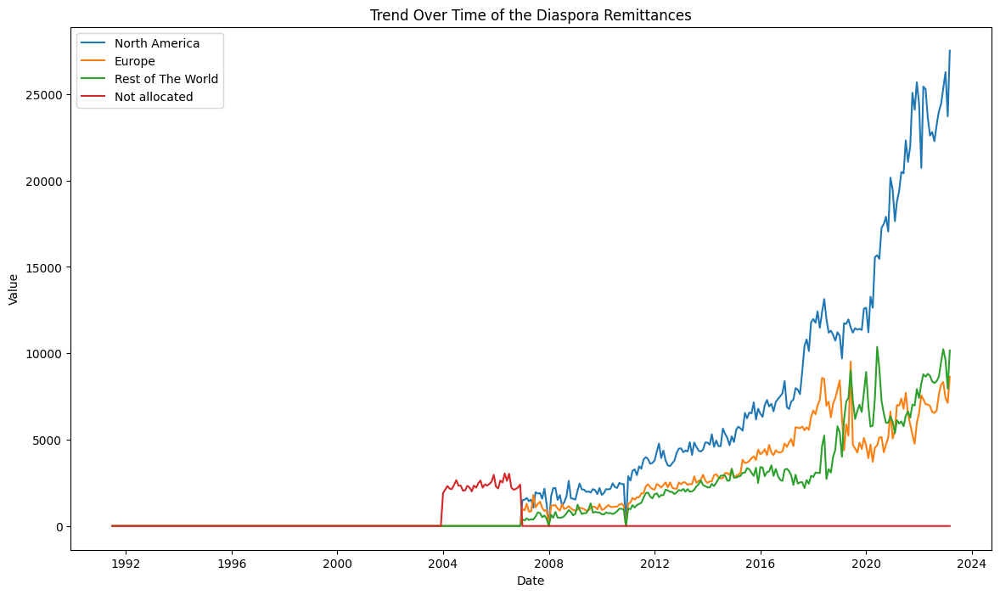

In [34]:
# Trend Analysis of the Diaspora Remittances

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['North America Diaspora Remittances (shillings million)'], label='North America')
plt.plot(clean_merged.index, clean_merged['Europe Diaspora Remittances (shillings million)'], label='Europe')
plt.plot(clean_merged.index, clean_merged['Rest of World Diaspora Remittances (shillings million)'], label='Rest of The World')
plt.plot(clean_merged.index, clean_merged['Not Allocated (shillings million)'], label='Not allocated')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of the Diaspora Remittances')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot


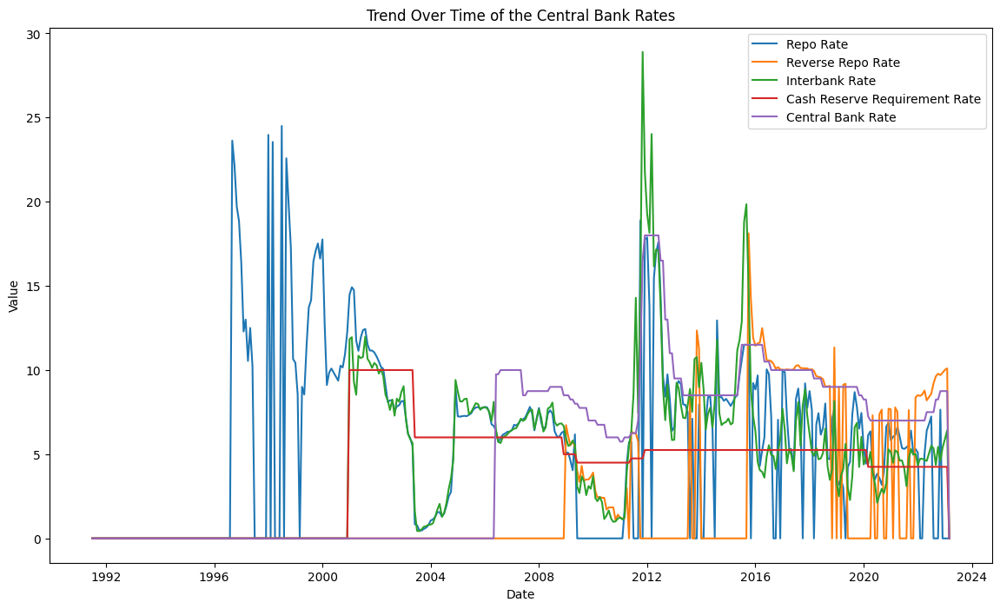

In [35]:
# Trend Analysis of Central bank rates

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Repo Rate'], label='Repo Rate')
plt.plot(clean_merged.index, clean_merged['Reverse Repo Rate'], label='Reverse Repo Rate')
plt.plot(clean_merged.index, clean_merged['Interbank Rate'], label='Interbank Rate')
plt.plot(clean_merged.index, clean_merged['Cash Reserve Requirement Rate'], label='Cash Reserve Requirement Rate')
plt.plot(clean_merged.index, clean_merged['Central Bank Rate'], label='Central Bank Rate')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of the Central Bank Rates')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot


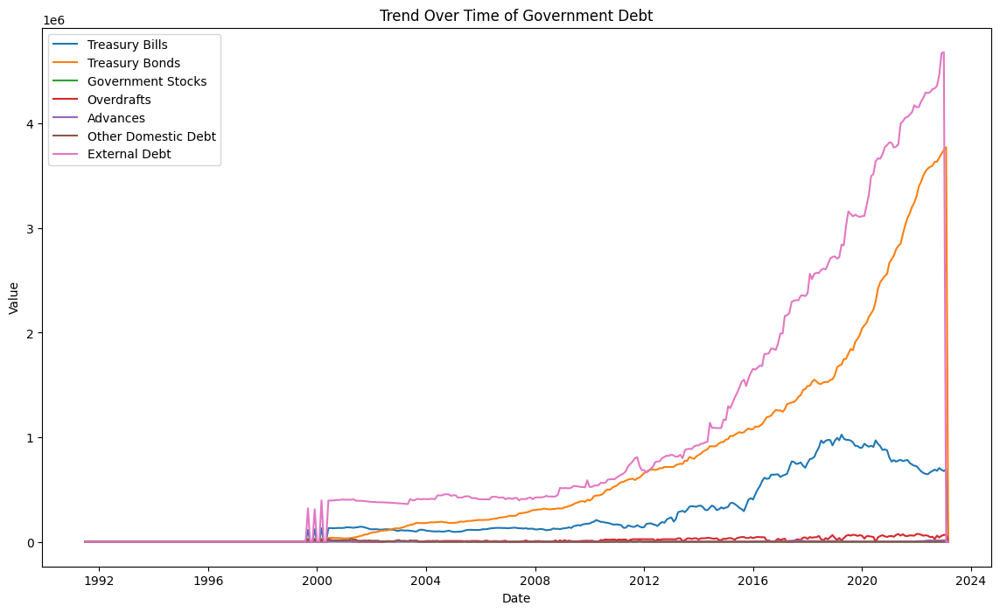

In [36]:
# Trend Analysis of Government Debt

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Treasury Bills* (shillings million)'], label='Treasury Bills')
plt.plot(clean_merged.index, clean_merged['Treasury Bonds (shillings million)'], label='Treasury Bonds')
plt.plot(clean_merged.index, clean_merged['Government Stocks (shillings million)'], label='Government Stocks')
plt.plot(clean_merged.index, clean_merged['Overdraft at Central Bank (shillings million)'], label='Overdrafts')
plt.plot(clean_merged.index, clean_merged['Advances from Commercial Banks (shillings million)'], label='Advances')
plt.plot(clean_merged.index, clean_merged['Other Domestic Debt** (shillings million)'], label='Other Domestic Debt')
plt.plot(clean_merged.index, clean_merged['External Debt (shillings million)'], label='External Debt')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Government Debt')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot


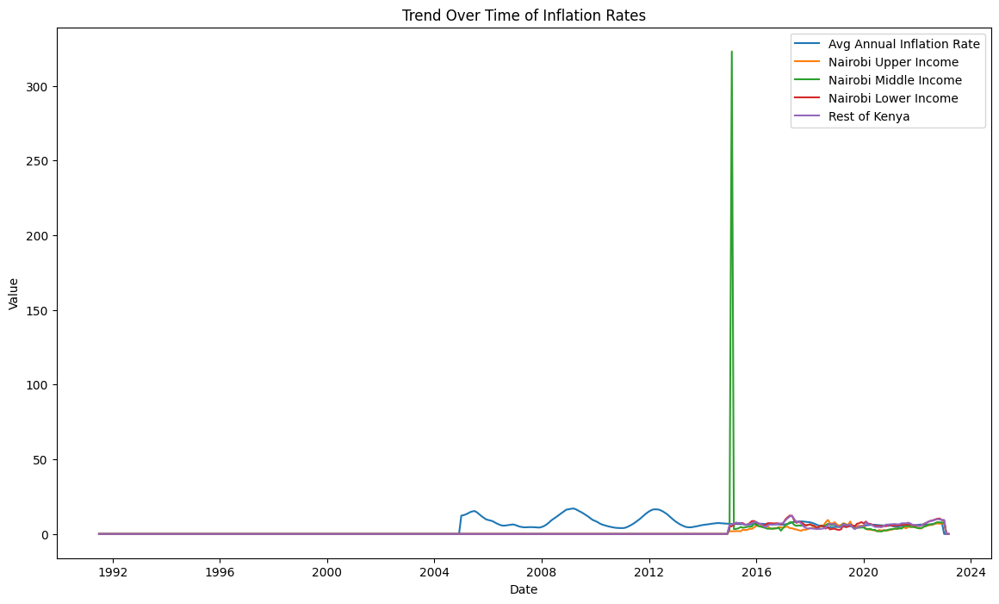

In [37]:
# Trend Analysis of Inflation Rates

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Average Annual Inflation Rate'], label='Avg Annual Inflation Rate')
plt.plot(clean_merged.index, clean_merged['Nairobi Upper Income Inflation Rate'], label='Nairobi Upper Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Middle Income Inflation Rate'], label='Nairobi Middle Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Lower Income Inflation Rate'], label='Nairobi Lower Income')
plt.plot(clean_merged.index, clean_merged['Rest of Kenya Inflation Rate'], label='Rest of Kenya')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Inflation Rates')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

In [38]:
# Create a threshold value for the Nairobi Middle Income Inflation Rate to investigate the outlier
value_threshold = 30  # Specify the threshold value

# Filter the DataFrame based on the condition
filtered_value = clean_merged[clean_merged['Nairobi Middle Income Inflation Rate'] > value_threshold]

# Print the filtered values
filtered_value.head()


,Year,Month,Repo Rate,Reverse Repo Rate,Interbank Rate,Cash Reserve Requirement Rate,Central Bank Rate,North America Diaspora Remittances (shillings million),Europe Diaspora Remittances (shillings million),Rest of World Diaspora Remittances (shillings million),Not Allocated (shillings million),Commercial Banks Weighted Average Deposit Rate,Commercial Banks Weighted Average Savings Rate,Commercial Banks Weighted Average Lending Rate,Commercial Banks Weighted Average Overdraft Rate,Treasury Bills* (shillings million),Treasury Bonds (shillings million),Government Stocks (shillings million),Overdraft at Central Bank (shillings million),Advances from Commercial Banks (shillings million),Other Domestic Debt** (shillings million),External Debt (shillings million),Average Annual Inflation Rate,Nairobi Upper Income Inflation Rate,Nairobi Middle Income Inflation Rate,Nairobi Lower Income Inflation Rate,Rest of Kenya Inflation Rate,Consumer Price Index,Real Estate Growth (shillings million - Annual),Nominal Annual GDP (shillings million - Annual),Annual GDP Rate
Month_Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-02-01,2015,February,7.87,0.0,6.77,5.25,8.5,5565.74566,2911.199906,2797.934371,0.0,6.68,1.53,15.47,15.67,335289.25,981873.08,0.0,34198.39,2647.73,170.946961,1296748.46,6.63,1.74,323.0,5.22,6.26,78.73,0.0,0.0,0.0


In [39]:
# Replace the value of this row  from the Nairobi Middle Income Inflation Rate due to typo error

row_index = '2015-02-01'  # Specify the row index
column_name = 'Nairobi Middle Income Inflation Rate'  # Replace with the actual column name
new_value = 3.23  # Specify the new value

# Modify the specific row value in the specified column
clean_merged.at[row_index, column_name] = new_value


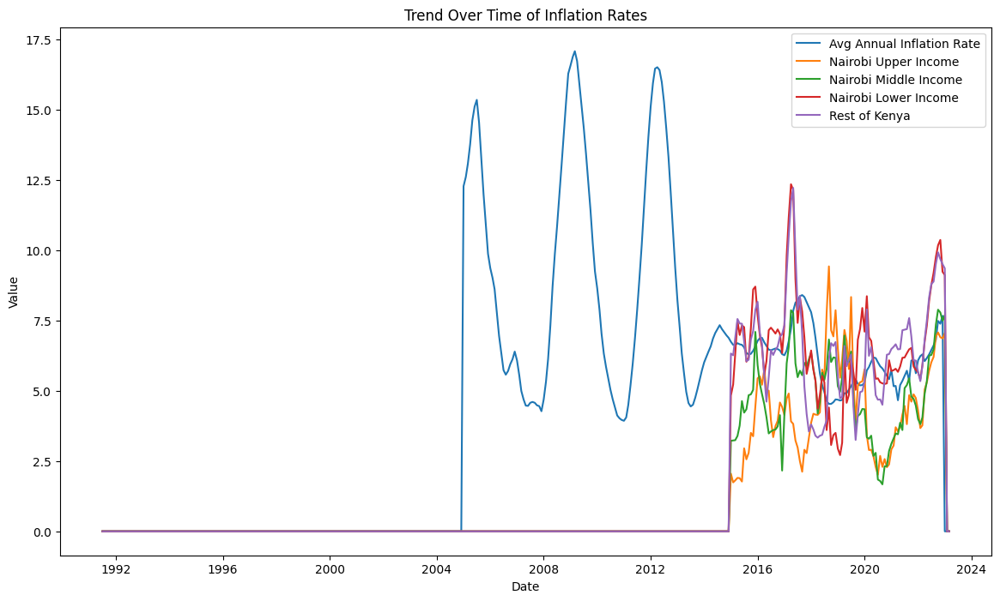

In [40]:
# Re-Plot the Trend Analysis of Inflation Rates

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Average Annual Inflation Rate'], label='Avg Annual Inflation Rate')
plt.plot(clean_merged.index, clean_merged['Nairobi Upper Income Inflation Rate'], label='Nairobi Upper Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Middle Income Inflation Rate'], label='Nairobi Middle Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Lower Income Inflation Rate'], label='Nairobi Lower Income')
plt.plot(clean_merged.index, clean_merged['Rest of Kenya Inflation Rate'], label='Rest of Kenya')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Inflation Rates')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

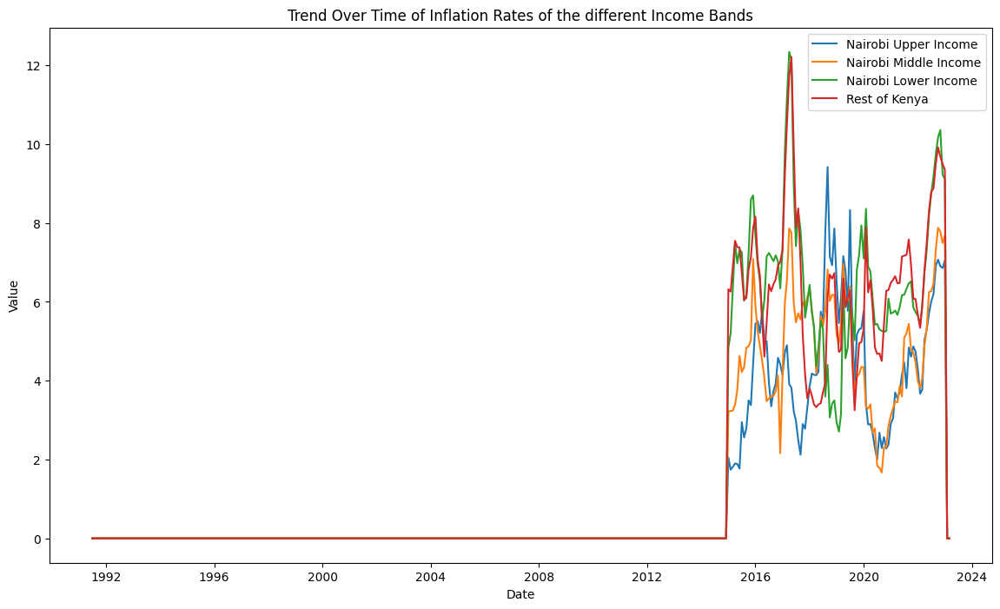

In [41]:
# Trend Analysis of Inflation Rates of the different Income bands

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Nairobi Upper Income Inflation Rate'], label='Nairobi Upper Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Middle Income Inflation Rate'], label='Nairobi Middle Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Lower Income Inflation Rate'], label='Nairobi Lower Income')
plt.plot(clean_merged.index, clean_merged['Rest of Kenya Inflation Rate'], label='Rest of Kenya')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Inflation Rates of the different Income Bands')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

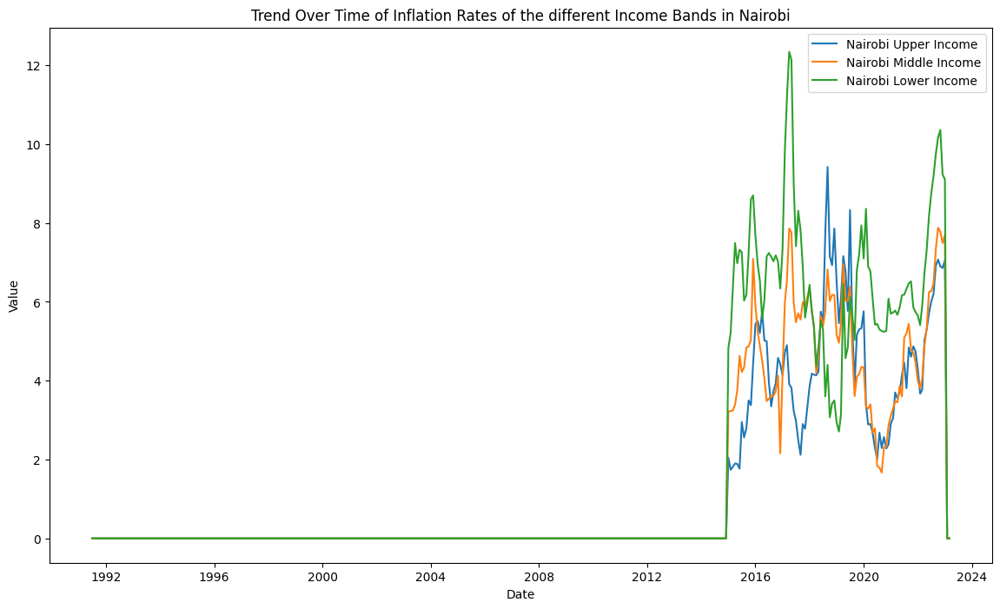

In [42]:
# Trend Analysis of Inflation Rates of the different Income bands in Nairobi

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Nairobi Upper Income Inflation Rate'], label='Nairobi Upper Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Middle Income Inflation Rate'], label='Nairobi Middle Income')
plt.plot(clean_merged.index, clean_merged['Nairobi Lower Income Inflation Rate'], label='Nairobi Lower Income')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Inflation Rates of the different Income Bands in Nairobi')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

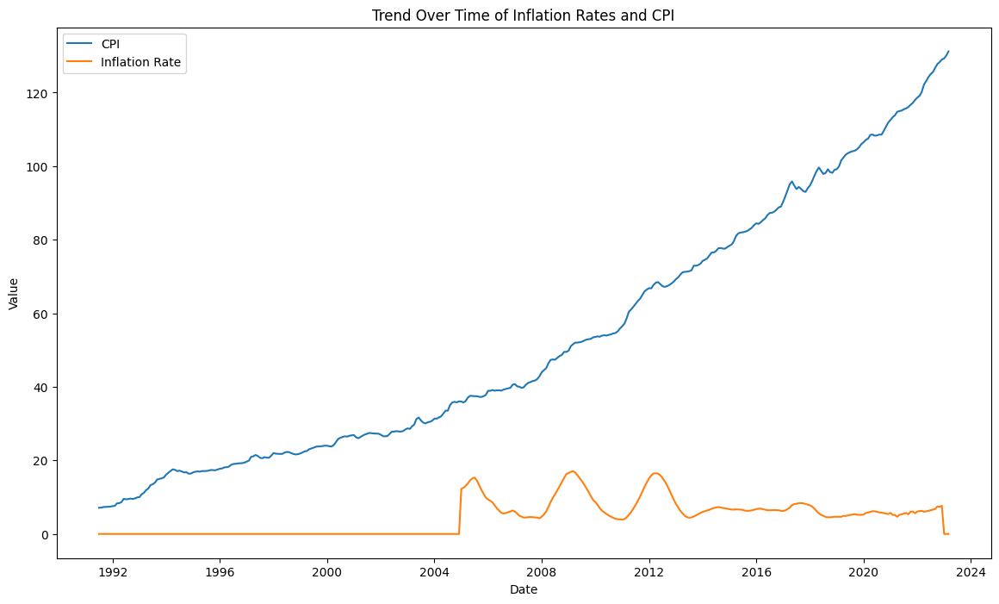

In [43]:
# Trend Analysis of Inflation Rates and CPI

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Consumer Price Index'], label='CPI')
plt.plot(clean_merged.index, clean_merged['Average Annual Inflation Rate'], label='Inflation Rate')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Inflation Rates and CPI')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

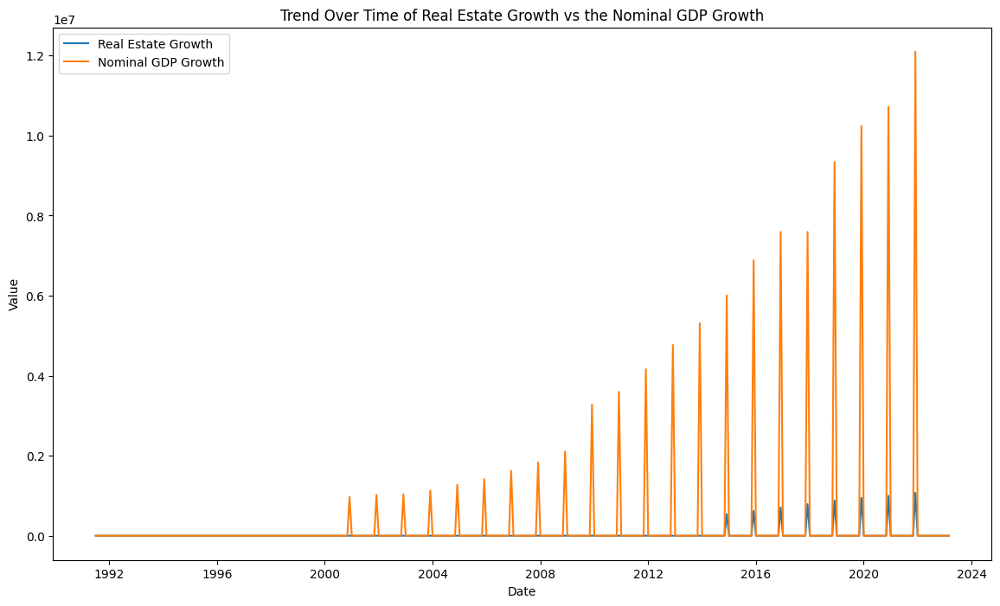

In [44]:
# Trend Analysis of Nominal Annual GDP and Real Estate Growth

plt.figure(figsize=(14, 8))  # Set the figure size
plt.plot(clean_merged.index, clean_merged['Real Estate Growth (shillings million - Annual)'], label='Real Estate Growth')
plt.plot(clean_merged.index, clean_merged['Nominal Annual GDP (shillings million - Annual)'], label='Nominal GDP Growth')

plt.xlabel('Date')  # Set the x-axis label
plt.ylabel('Value')  # Set the y-axis label
plt.title('Trend Over Time of Real Estate Growth vs the Nominal GDP Growth')  # Set the plot title
plt.legend()  # Display the legend
plt.show()  # Show the plot

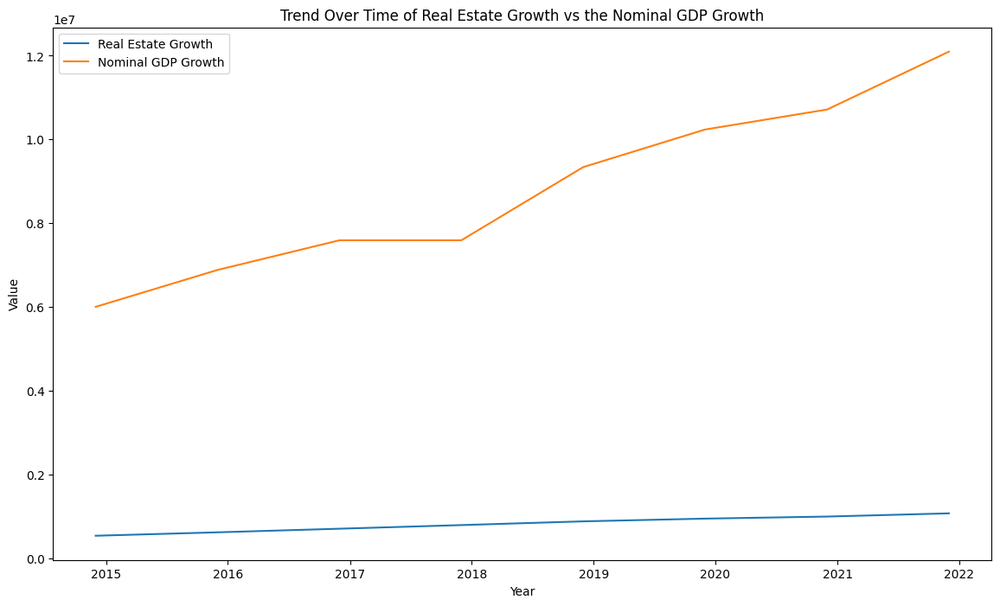

In [45]:
# Filter out zero values from Real Estate Growth and Nominal GDP Growth (Filter the zeros)
filtered_RGDP_df = clean_merged[(clean_merged['Real Estate Growth (shillings million - Annual)'] != 0) & 
                           (clean_merged['Nominal Annual GDP (shillings million - Annual)'] != 0)]

# Plot the line graph
plt.figure(figsize=(14, 8))

plt.plot(filtered_RGDP_df.index, filtered_RGDP_df['Real Estate Growth (shillings million - Annual)'], label='Real Estate Growth')
plt.plot(filtered_RGDP_df.index, filtered_RGDP_df['Nominal Annual GDP (shillings million - Annual)'], label='Nominal GDP Growth')

plt.xlabel('Year')
plt.ylabel('Value')
plt.title('Trend Over Time of Real Estate Growth vs the Nominal GDP Growth')
plt.legend()
plt.show()

### **Notes from Trend Analysis**

The commercial bank weighted average rates i.e savings rate, lending rate, deposit rate and savings rate are all moving in the same trend with overdraft and lending rates being the highest followed by deposit rate and lasty savings rate. The highest commercial bank rates were recorded between 1994 and 1999. This was probably influenced by an economic crisis where the World Bank withheld aid until the then President (The Late Moi) agreed to economic reforms. Additionally there was political unrest following the re-election of the Late Moi.

Diaspora remittances have had an upward trend through the years where North America has dominated with the highest value in remittances followed closely by Europe. However since 2020, the value of Europe has dropped and has been overtaken by the Rest of the World. This could mean that either the diasporians are no longer immigrating to Europe or they have withdrawn from sending money to Kenya.

Central Bank rate are quite volatile with no trend. These rates include repo rate, reverse repo rate, interbank rate and cash reserve requirement Rate.

The highest government debt is from external debt followed closely by treasury bonds which have both been on an upward trend through the years. The value of treasury bills has been on a downward trend since 2019.

Nairobi low income earners are the hardest hit as they have the highest rate of inflation followed by the middle income earners. Between 2019 and 2020, the Nairobi high income earners were hit the hardest by inflation rate. This could have been influenced by the olitical uncertainity from the handshake between the former Kenyan president, Uhuru Kenyatta and Raila Odinga and also the bombing in one of Nairobi's plush areas i.e. Dusit D2.

The consumer price index has been on an upward trend over the years compared to the inflation rate that has experienced a schostatic trend as the values seem to go down for a while then pick up for awhile.

The real estate growth is synonymous with the annual GDP growth.

### **3.2 Descriptive Analysis**

In [47]:
# Shape of the dataset

print("The shape of the dataset: ", clean_merged.shape)

The shape of the dataset:  (381, 31)


In [48]:
# Descriptive analysis of the variables

clean_merged.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,381.0,2006.874016,9.184935e+00,1991.000000,1999.00,2007.000000,2.015000e+03,2.023000e+03
Repo Rate,381.0,5.668215,5.330946e+00,0.000000,0.00,6.160000,8.300000e+00,2.450000e+01
Reverse Repo Rate,381.0,2.026352,3.842681e+00,0.000000,0.00,0.000000,1.230000e+00,1.812000e+01
Interbank Rate,381.0,4.600525,4.473792e+00,0.000000,0.00,4.630000,7.180000e+00,2.890000e+01
Cash Reserve Requirement Rate,381.0,4.003281,2.955952e+00,0.000000,0.00,5.250000,5.250000e+00,1.000000e+01
Central Bank Rate,381.0,4.787402,4.866245e+00,0.000000,0.00,6.000000,8.750000e+00,1.800000e+01
North America Diaspora Remittances (shillings million),381.0,4291.443876,6.597510e+03,0.000000,0.00,1281.661053,5.651489e+03,2.751524e+04
Europe Diaspora Remittances (shillings million),381.0,1893.228197,2.475866e+03,0.000000,0.00,872.369368,3.261053e+03,9.518213e+03
Rest of World Diaspora Remittances (shillings million),381.0,1723.028090,2.547797e+03,0.000000,0.00,374.196911,2.659866e+03,1.036800e+04
Not Allocated (shillings million),381.0,223.130555,6.965250e+02,0.000000,0.00,0.000000,0.000000e+00,3.044562e+03


### **Descriptive Analysis notes**

The data spans from July 1991 to February 2023. The above descriptive analysis provides information about the mean and standard deviation of the macro economic factors in the dataset. It also helps us identify the presence of outliers in the dataset which is present in all the variables.

The dataset contains 381 row values and 31 variables.

### **3.3 Univariate Analysis**

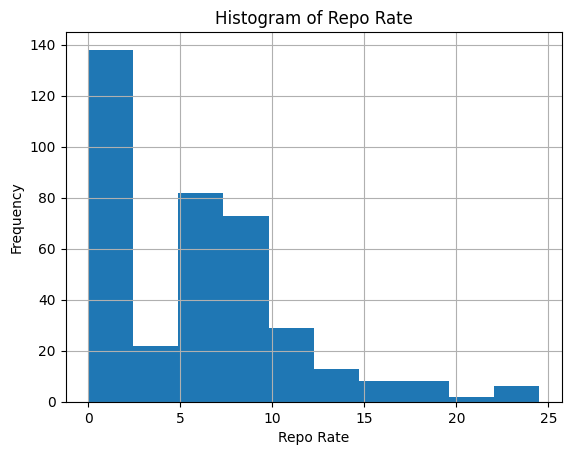

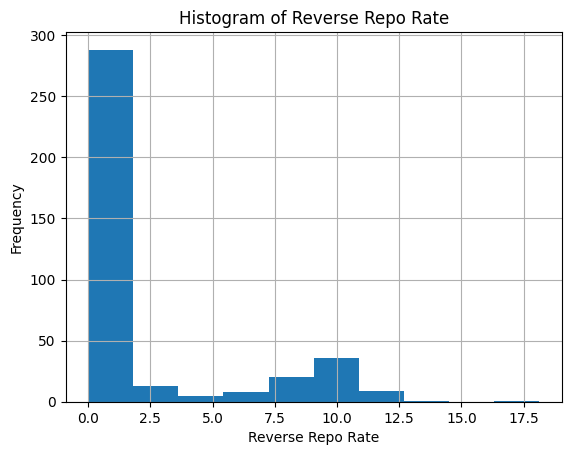

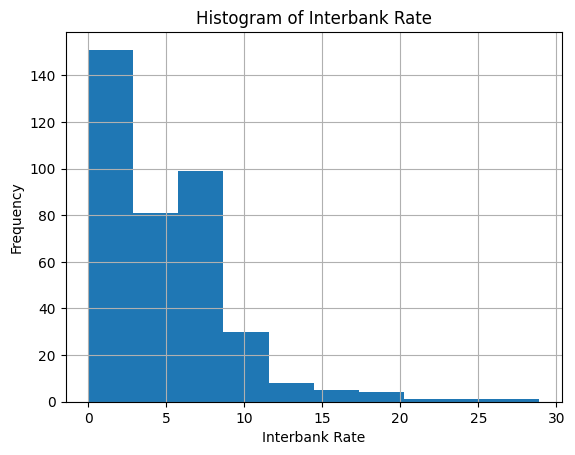

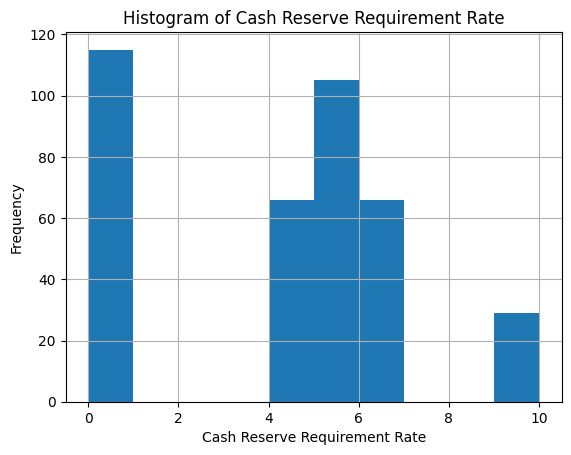

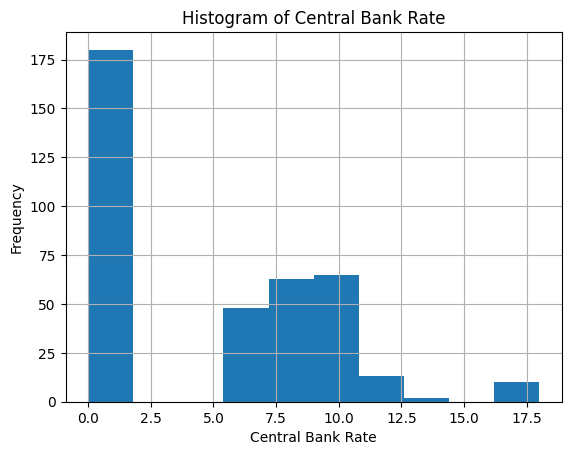

...

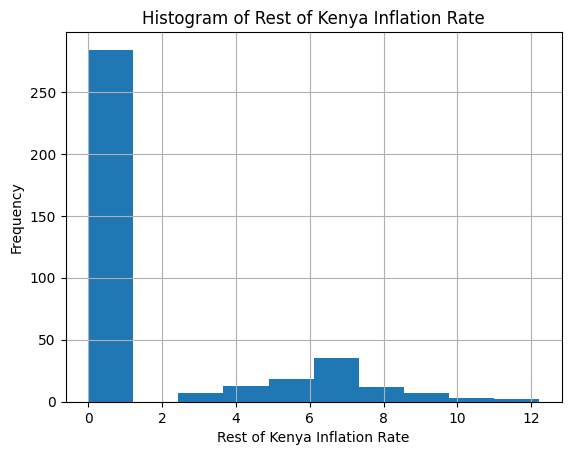

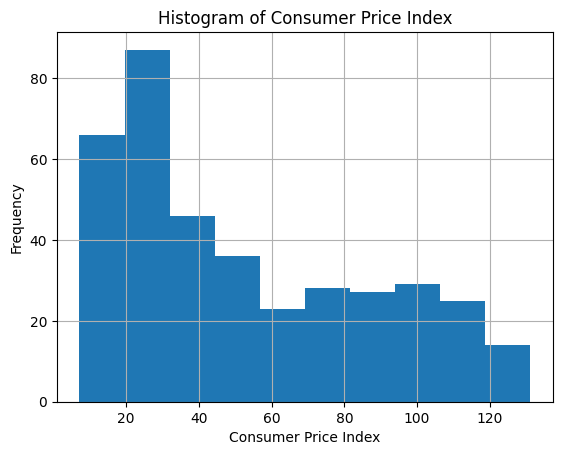

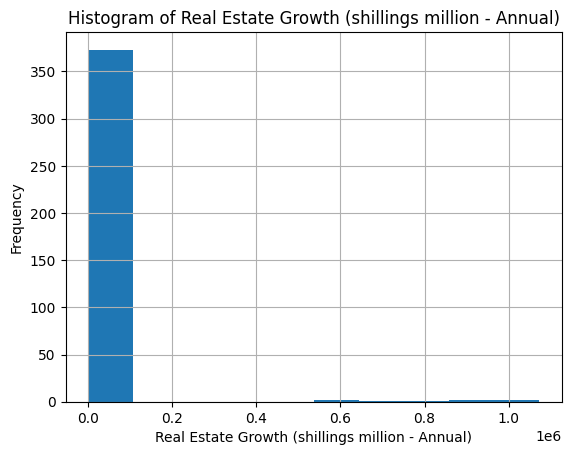

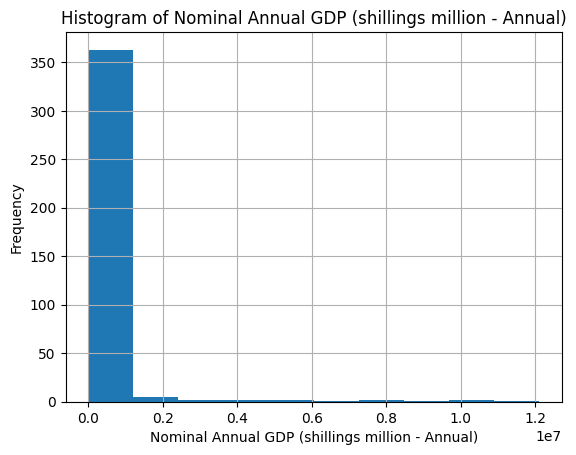

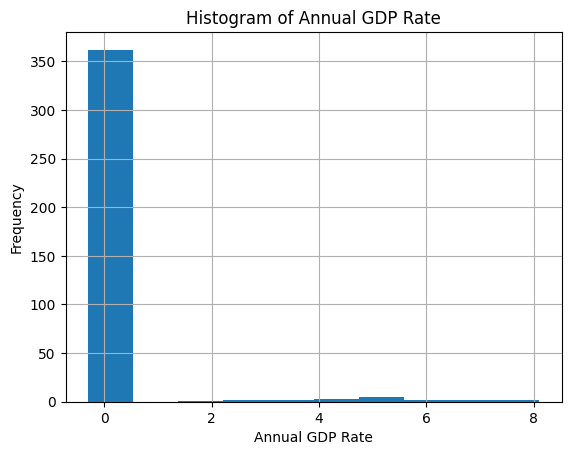

In [49]:
# Histogram analysis of the variables

# List of variables to analyze
variables = ['Repo Rate', 'Reverse Repo Rate', 'Interbank Rate',
       'Cash Reserve Requirement Rate', 'Central Bank Rate',
       'North America Diaspora Remittances (shillings million)',
       'Europe Diaspora Remittances (shillings million)',
       'Rest of World Diaspora Remittances (shillings million)',
       'Not Allocated (shillings million)',
       'Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate',
       'Treasury Bills* (shillings million)',
       'Treasury Bonds (shillings million)',
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)',
       'External Debt (shillings million)', 'Average Annual Inflation Rate',
       'Nairobi Upper Income Inflation Rate',
       'Nairobi Middle Income Inflation Rate',
       'Nairobi Lower Income Inflation Rate', 'Rest of Kenya Inflation Rate',
       'Consumer Price Index',
       'Real Estate Growth (shillings million - Annual)',
       'Nominal Annual GDP (shillings million - Annual)', 'Annual GDP Rate',]

# Loop through each variable
for variable in variables:
    
    # Plot a histogram
    clean_merged[variable].hist()
    plt.title(f'Histogram of {variable}')
    plt.xlabel(variable)
    plt.ylabel('Frequency')
    plt.show()

In [50]:
# Plot box plots 

# Set the figure size
plt.rcParams["figure.figsize"] = [10, 6]
plt.rcParams["figure.autolayout"] = True


In [51]:
# Filter out zero values from the columns

filtered_zero = clean_merged.loc[:, (clean_merged != 0).any()]

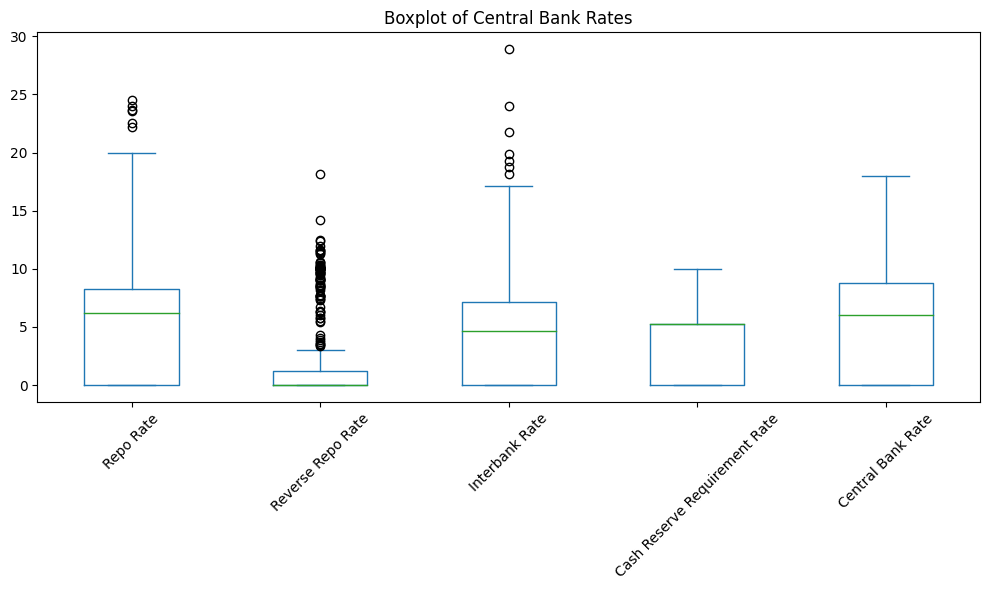

In [52]:
# Plot box plots of the central bank rates

ax = filtered_zero[['Repo Rate', 'Reverse Repo Rate', 'Interbank Rate',
       'Cash Reserve Requirement Rate', 'Central Bank Rate']].plot(kind='box', title='Boxplot of Central Bank Rates')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()


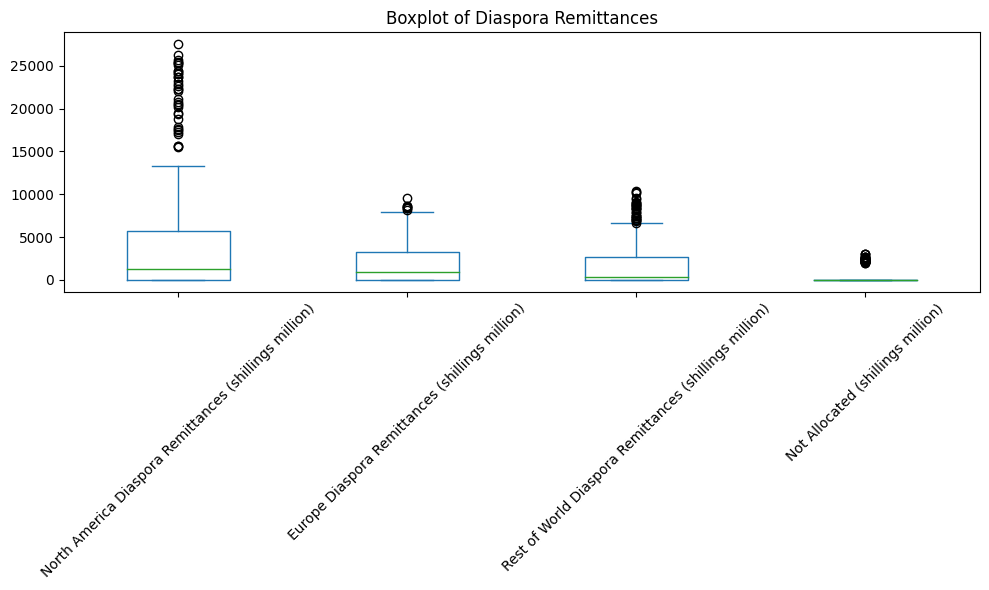

In [53]:
# Plot box plots of the Diaspora Remittances

ax = filtered_zero[['North America Diaspora Remittances (shillings million)',
       'Europe Diaspora Remittances (shillings million)',
       'Rest of World Diaspora Remittances (shillings million)',
       'Not Allocated (shillings million)']].plot(kind='box', title='Boxplot of Diaspora Remittances')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()


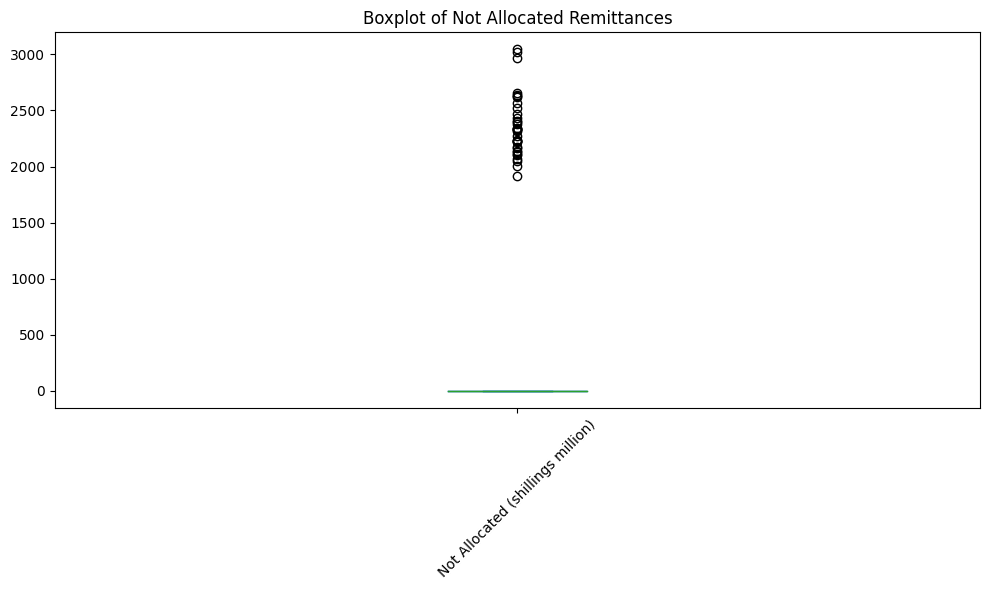

In [54]:
# Plot Not Allocated Remittances to see it better

ax = filtered_zero[['Not Allocated (shillings million)']].plot(kind='box', title='Boxplot of Not Allocated Remittances')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

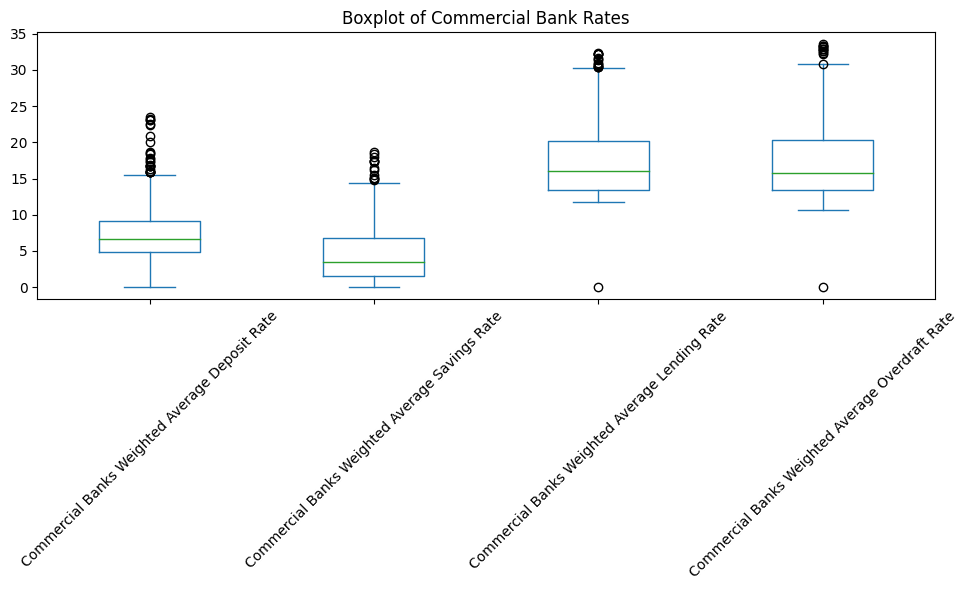

In [55]:
# Plot box plots of the Commercial Bank Rates

# Plot the dataframe
ax = filtered_zero[['Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate']].plot(kind='box', title='Boxplot of Commercial Bank Rates')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

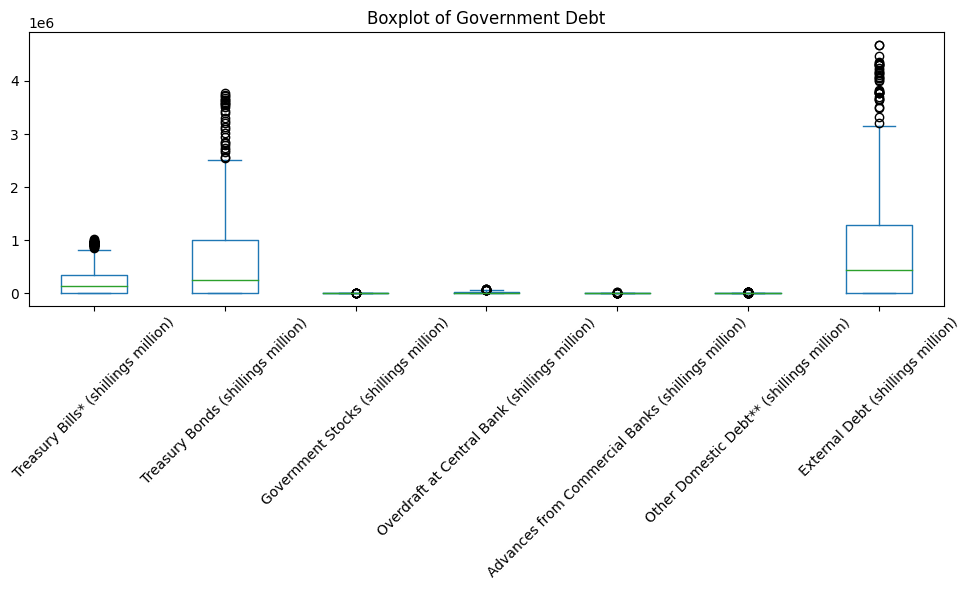

In [56]:
# Plot box plots of the Government Debt

ax = filtered_zero[['Treasury Bills* (shillings million)',
       'Treasury Bonds (shillings million)',
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)',
       'External Debt (shillings million)']].plot(kind='box', title='Boxplot of Government Debt')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

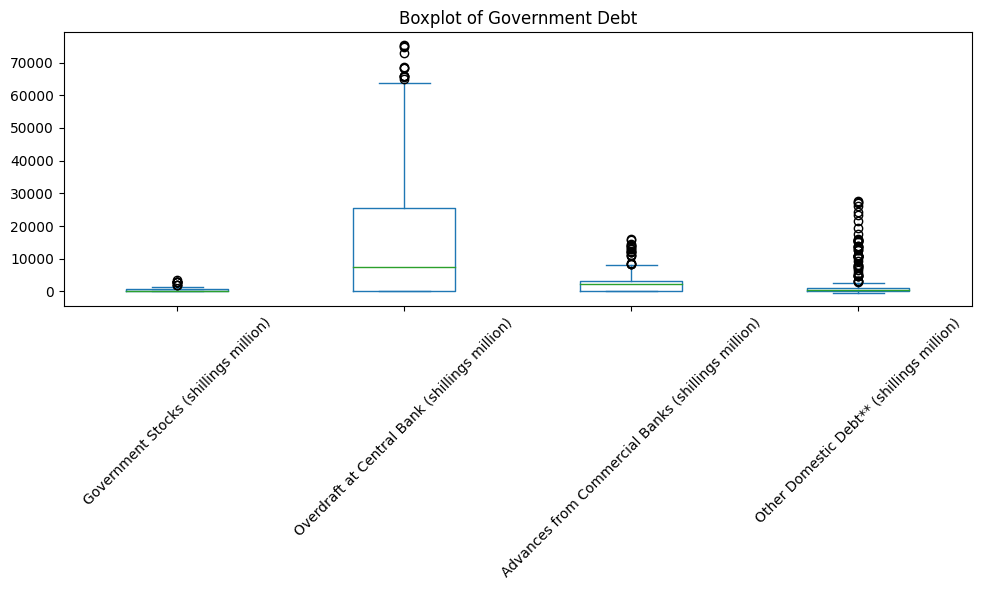

In [57]:
# Plot Govt stocks, over draft advances from commercial banks and other domestic debt separately

ax = filtered_zero[[
       'Government Stocks (shillings million)',
       'Overdraft at Central Bank (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)'
       ]].plot(kind='box', title='Boxplot of Government Debt')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

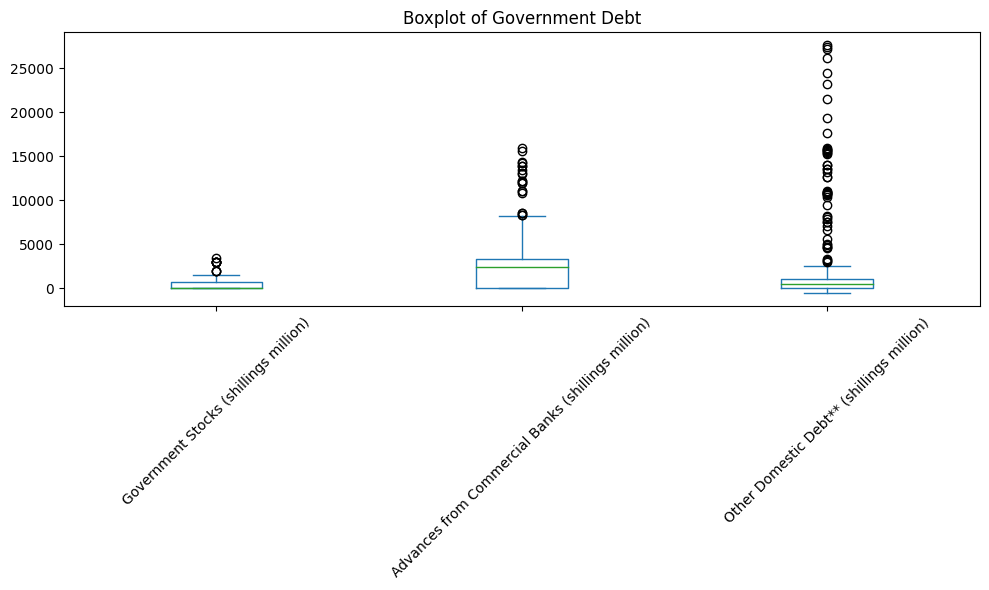

In [58]:
# Plot Govt stocks, advances and other domestic debt separately

ax = filtered_zero[[
       'Government Stocks (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Other Domestic Debt** (shillings million)'
       ]].plot(kind='box', title='Boxplot of Government Debt')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

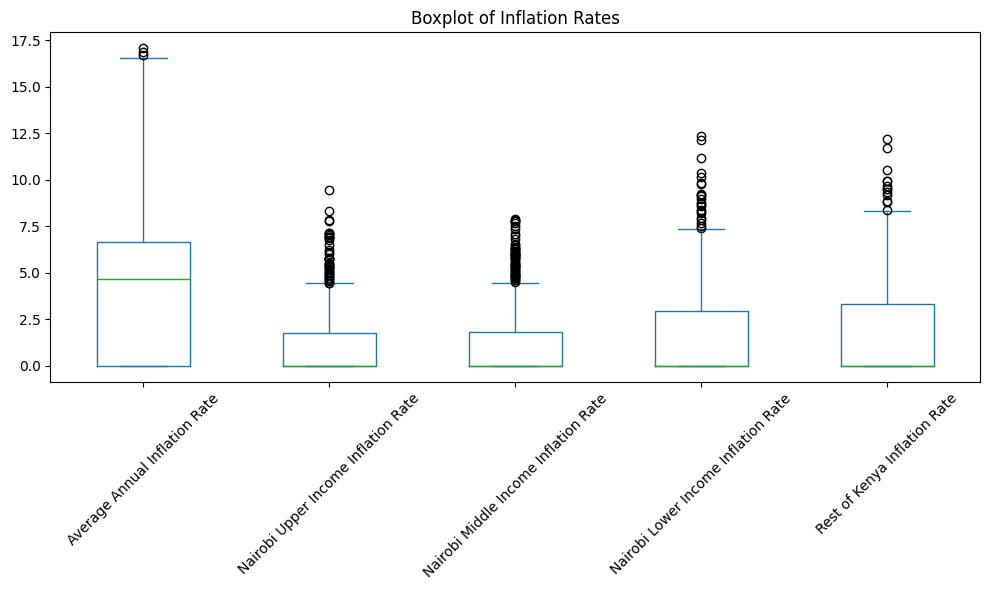

In [59]:
# Plot box plots of the Inflation Rates of the various income bands

# Plot the dataframe
ax = filtered_zero[['Average Annual Inflation Rate', 'Nairobi Upper Income Inflation Rate',
       'Nairobi Middle Income Inflation Rate',
       'Nairobi Lower Income Inflation Rate', 'Rest of Kenya Inflation Rate'
       ]].plot(kind='box', title='Boxplot of Inflation Rates')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

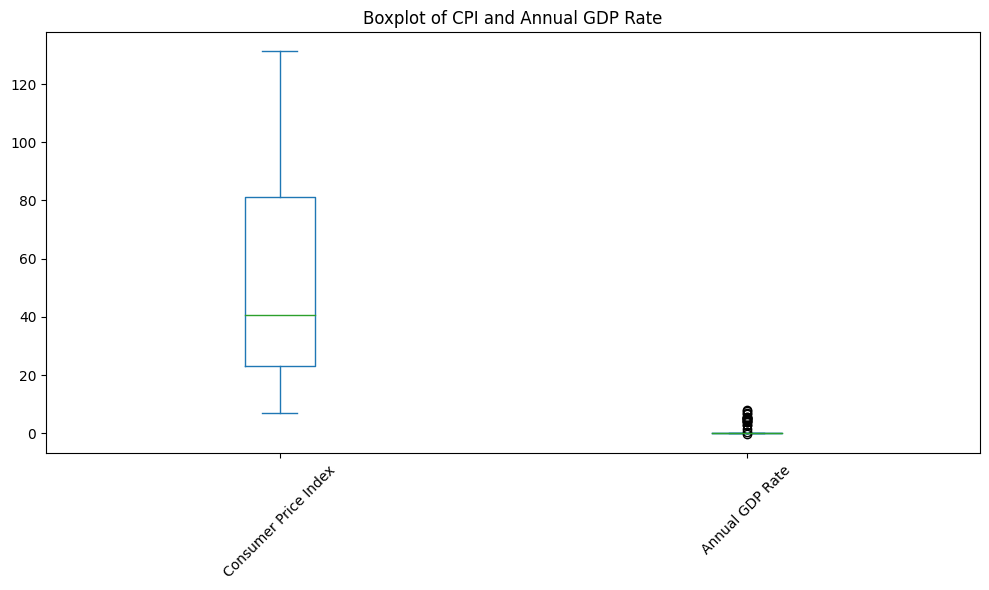

In [60]:
# Plot box plots of the CPI and Annual GDP Rate

# Plot the dataframe
ax = filtered_zero[['Consumer Price Index', 'Annual GDP Rate',
       ]].plot(kind='box', title='Boxplot of CPI and Annual GDP Rate')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

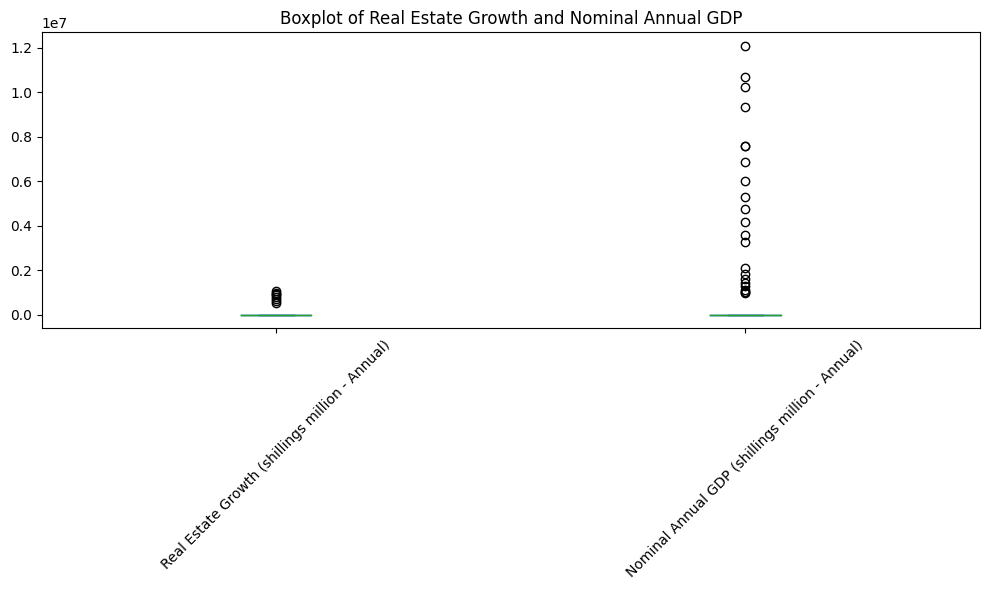

In [61]:
# Plot box plots of the Real Estate Growth and Nominal Annual GDP

ax = filtered_zero[['Real Estate Growth (shillings million - Annual)',
       'Nominal Annual GDP (shillings million - Annual)',
       ]].plot(kind='box', title='Boxplot of Real Estate Growth and Nominal Annual GDP')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

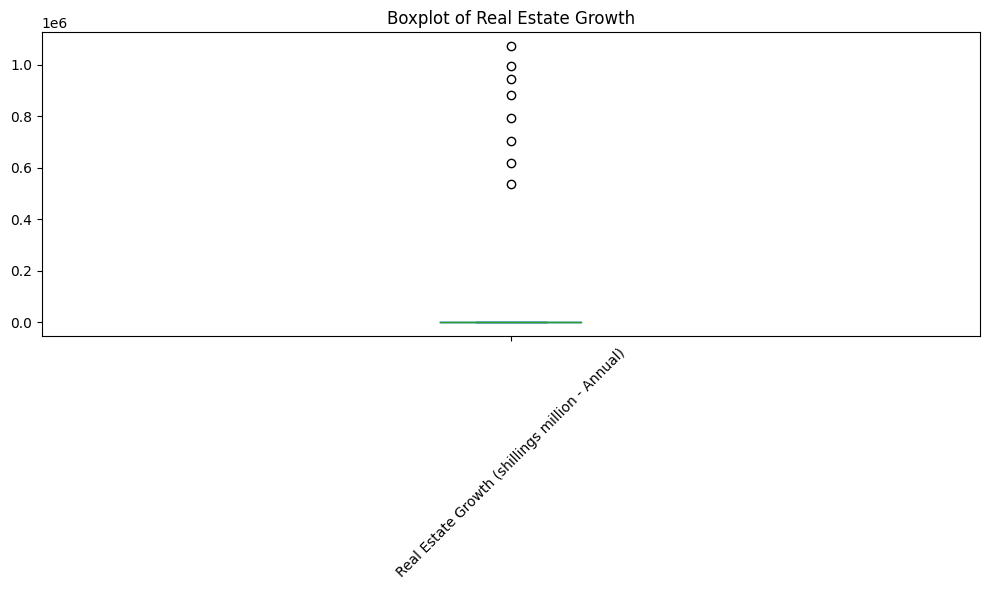

In [62]:
# Plot box plots of the Real Estate Growth separately

ax = filtered_zero[['Real Estate Growth (shillings million - Annual)'
       ]].plot(kind='box', title='Boxplot of Real Estate Growth')

# Set the x-axis tick labels at a 45-degree angle
plt.xticks(rotation=45)

# Display the plot
plt.show()

In [63]:
# Confirm the normality of select variables

# Perform the Shapiro-Wilk test for each variable
for var in variables:
    # Extract the variable from the DataFrame
    variable_name = clean_merged[var]
    
    # Perform the Shapiro-Wilk test
    statistic, p_value = stats.shapiro(variable_name)
    
    # Print the results
    print("Shapiro-Wilk Test for", var)
    print("Statistic:", statistic)
    print("p-value:", p_value)
    
    # Interpret the results
    alpha = 0.05  # Significance level
    if p_value > alpha:
        print("The variable", var, "is normally distributed (fail to reject H0)")
    else:
        print("The variable", var, "is not normally distributed (reject H0)")
    
    print()  # Add a line break between variables


Shapiro-Wilk Test for Repo Rate
Statistic: 0.8792731165885925
p-value: 1.0650604851920883e-16
The variable Repo Rate is not normally distributed (reject H0)

Shapiro-Wilk Test for Reverse Repo Rate
Statistic: 0.5771549344062805
p-value: 2.2726259223995503e-29
The variable Reverse Repo Rate is not normally distributed (reject H0)

Shapiro-Wilk Test for Interbank Rate
Statistic: 0.8621577620506287
p-value: 7.363389759379641e-18
The variable Interbank Rate is not normally distributed (reject H0)

Shapiro-Wilk Test for Cash Reserve Requirement Rate
Statistic: 0.8283544182777405
p-value: 7.150840039966824e-20
The variable Cash Reserve Requirement Rate is not normally distributed (reject H0)

Shapiro-Wilk Test for Central Bank Rate
Statistic: 0.7999058365821838
p-value: 2.3870693702627527e-21
The variable Central Bank Rate is not normally distributed (reject H0)

Shapiro-Wilk Test for North America Diaspora Remittances (shillings million)
Statistic: 0.6977548003196716
p-value: 1.330868990789

In [64]:
# Confirm the skewness of all variables

# Calculate skewness for each column
skewness = clean_merged.skew()

# Print the skewness for each column
print(skewness)

Year                                                     -0.000583
Repo Rate                                                 0.884508
Reverse Repo Rate                                         1.643400
Interbank Rate                                            1.315863
Cash Reserve Requirement Rate                            -0.040482
Central Bank Rate                                         0.390450
North America Diaspora Remittances (shillings million)    1.826104
Europe Diaspora Remittances (shillings million)           1.130593
Rest of World Diaspora Remittances (shillings million)    1.624854
Not Allocated (shillings million)                         2.859844
Commercial Banks Weighted Average Deposit Rate            1.247686
Commercial Banks Weighted Average Savings Rate            1.148285
Commercial Banks Weighted Average Lending Rate            0.903008
Commercial Banks Weighted Average Overdraft Rate          0.929657
Treasury Bills* (shillings million)                       1.18

<ipython-input-64-1e49ee47e4b4>:4: FutureWarning: The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  skewness = clean_merged.skew()


### **Notes from Univariate Analysis**

Univariate analysis i.e. the use of histograms and boxplots, plays a crucial role in understanding data distributions, detecting outliers and summarizing data characteristics to provide insights into individual variables. From the univariate analysis done, the following insights were extracted: 

- None of the variables is normally distributed.

- The cash reserve requirement rate variable is the only variable in the dataset whose values are skewed to the left. This means that a majority of these values are concentrated towards the smaller values and the mean is less than the median. 

- The rest of the variables have their values skewed to the right meaning that a majority of the values are concentrated towards the larger values and the mean is greater than the median.

- Variables without outliers are the consumer price index, central bank rate and cash reserve requirement rate. The presence of outliers in the other variables could be influenced by uncertain economic conditions.


### **3.4 Correlation Analysis**

In [65]:
# Remove columns not needed for the correlation analysis

drop_columns = ['Year', 'Month']
corr_data = clean_merged.drop(columns = drop_columns, inplace=False)

# Compute correlations
corrs = corr_data.corr()


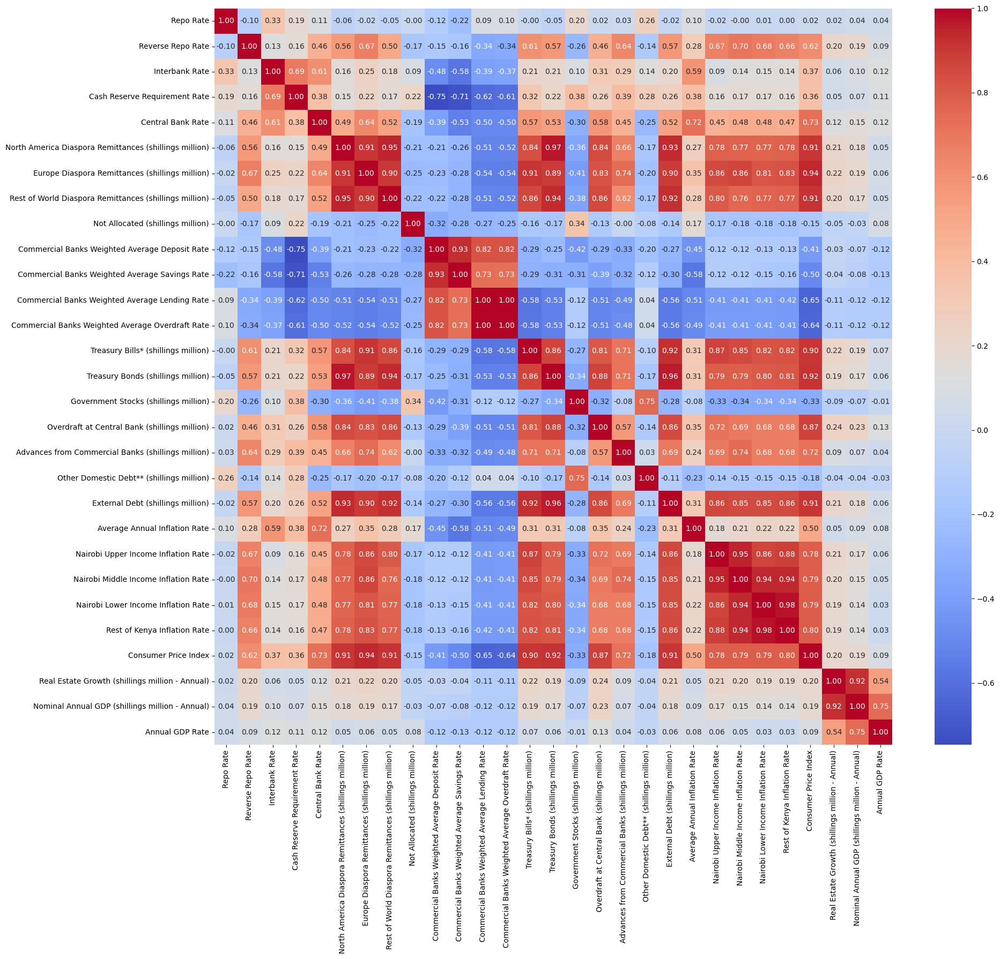

In [66]:
# Set plot size
fig, ax = plt.subplots(figsize=(20, 18))

# Print correlation matrix as heatmap
sns.heatmap(corrs, cmap='coolwarm', annot=True, fmt='.2f', ax=ax)
plt.show()


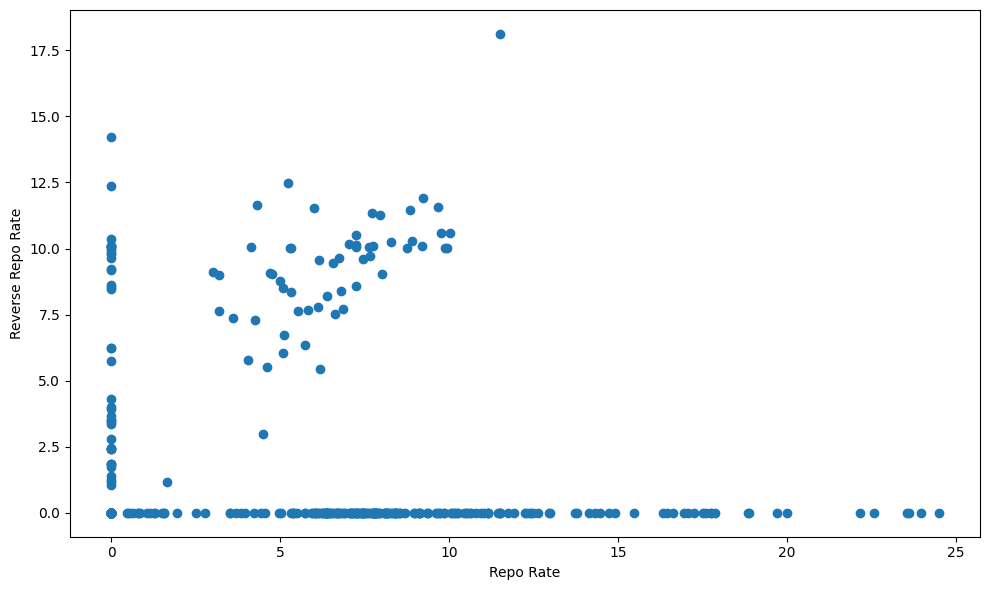

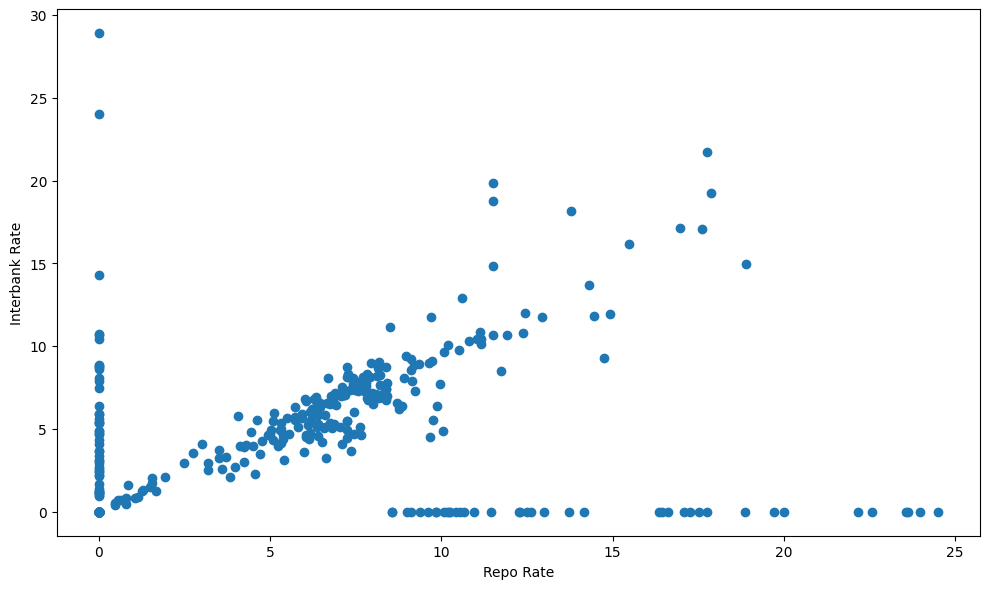

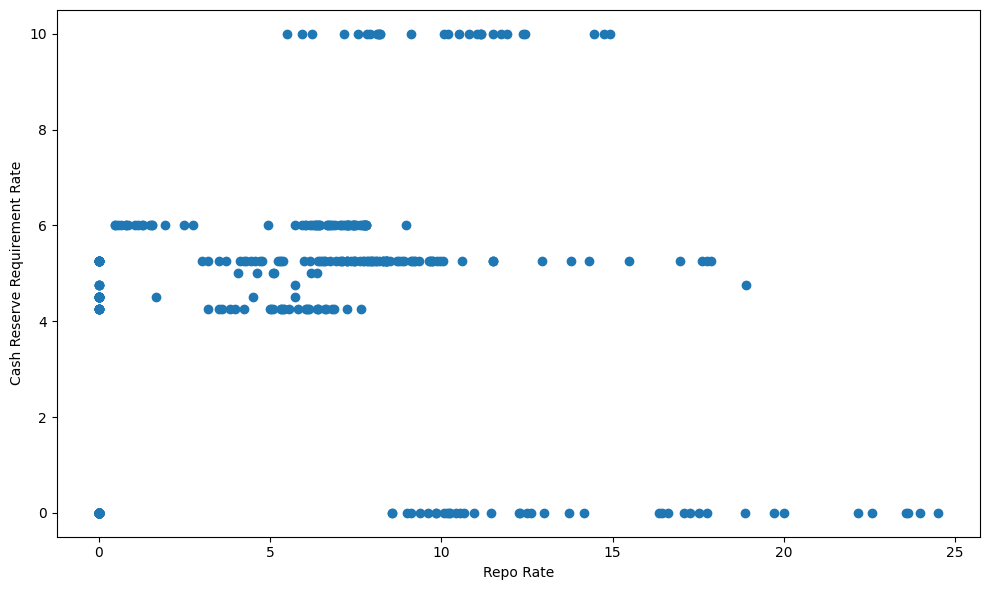

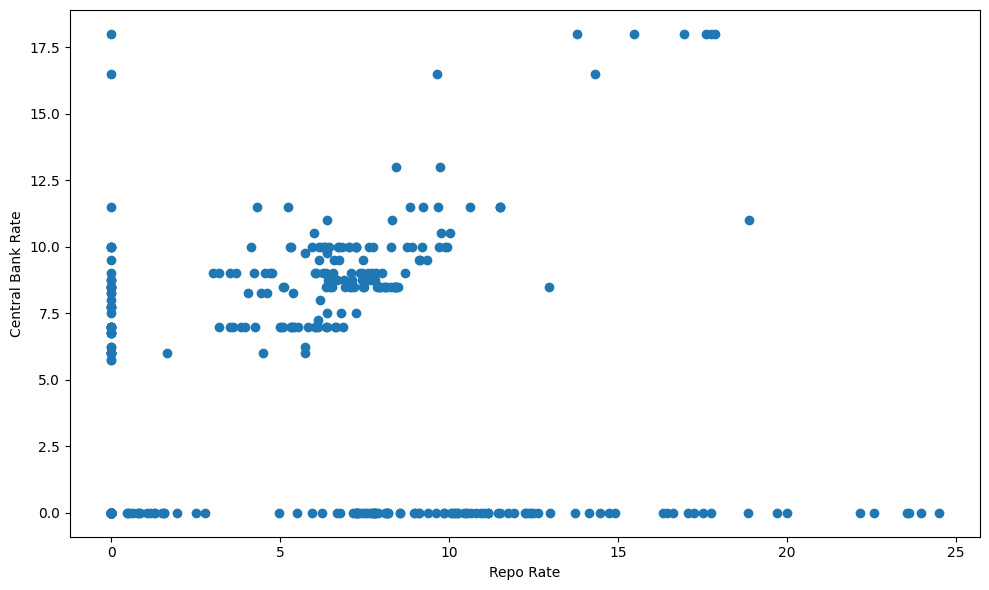

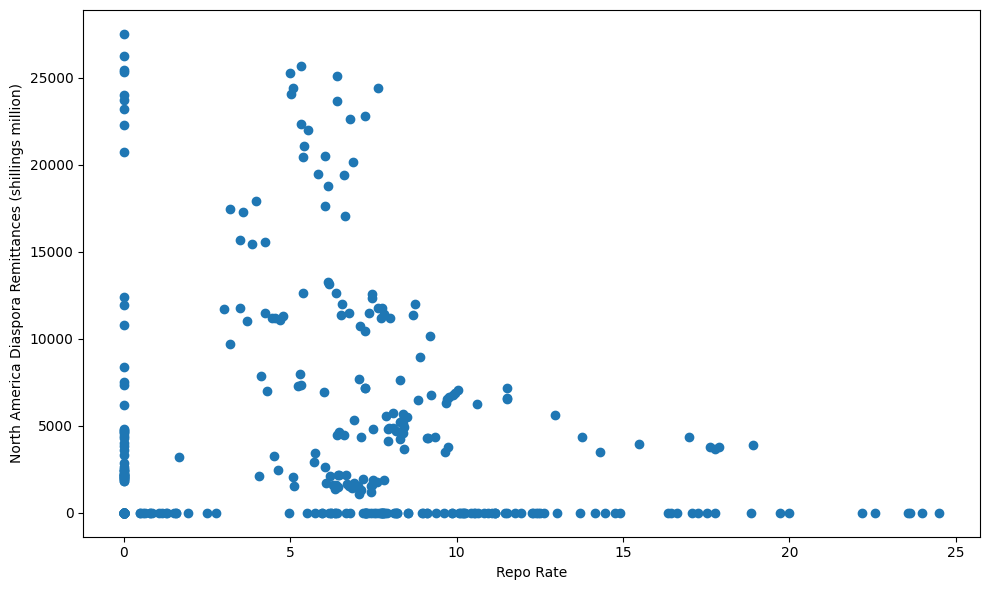

...

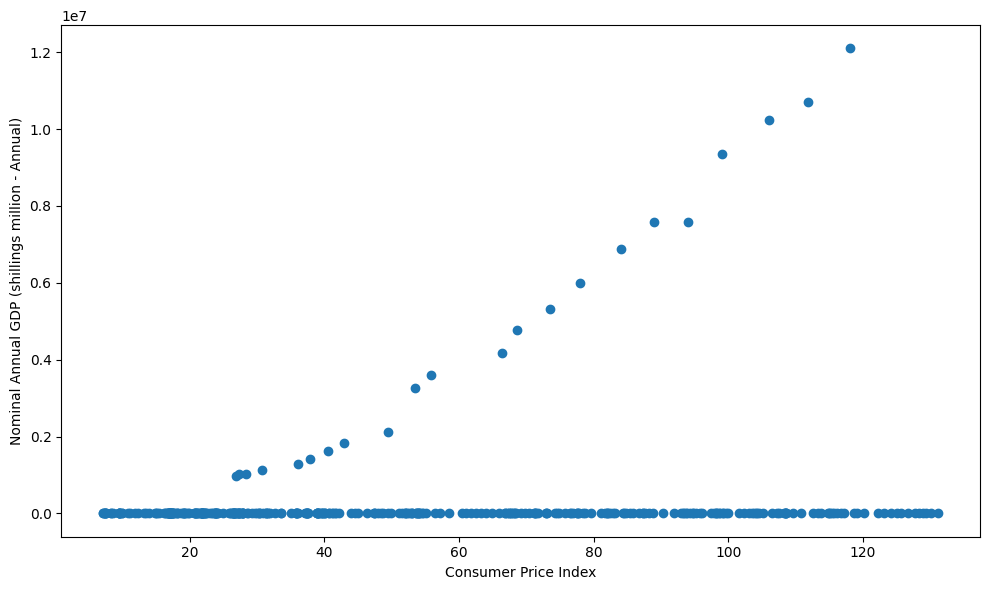

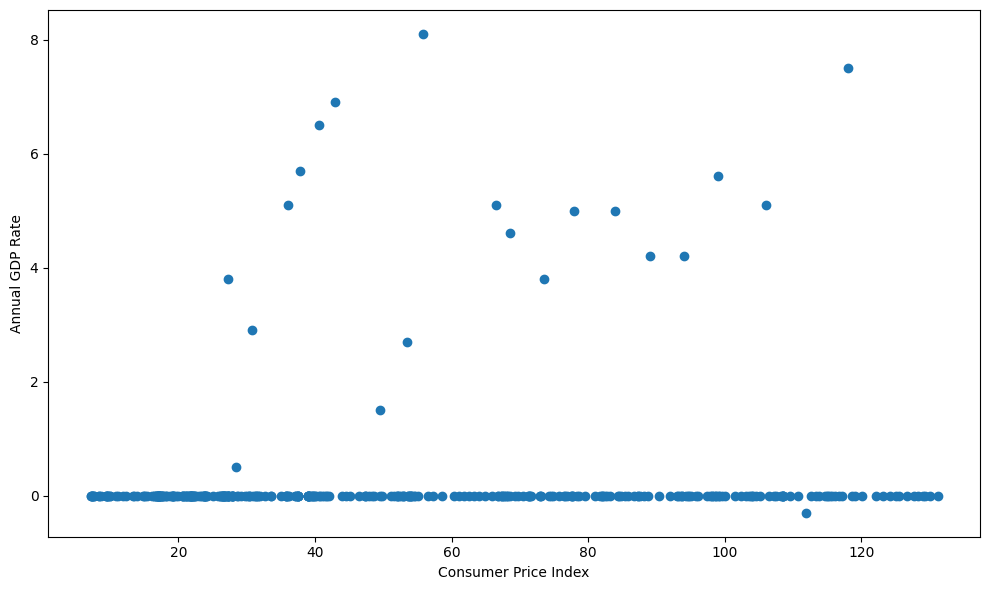

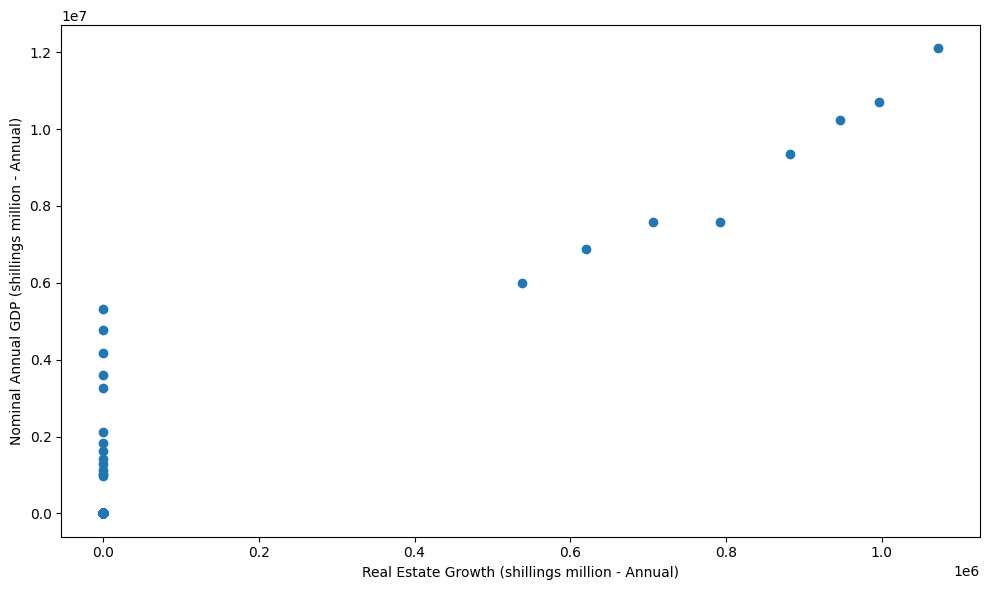

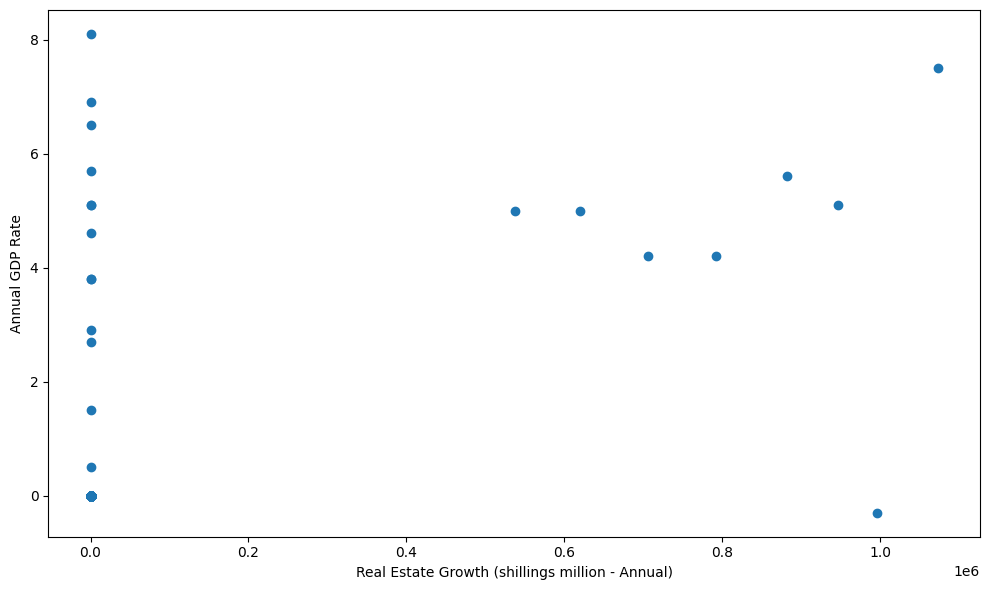

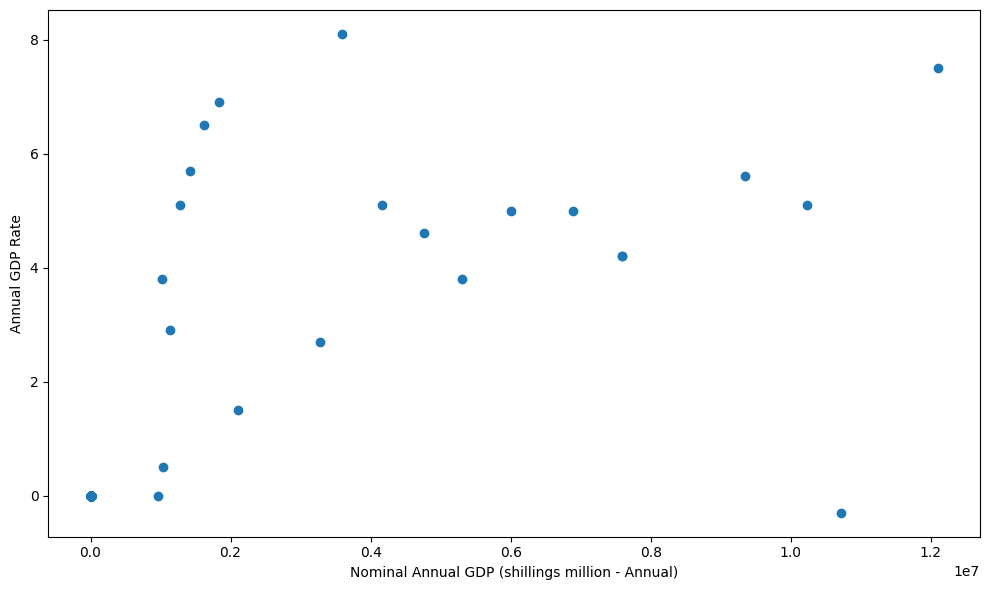

In [67]:
scatter_variables = corr_data.columns

# Generate scatter plots
for i in range(len(scatter_variables)):
    for j in range(i+1, len(variables)):
        plt.scatter(corr_data[variables[i]], corr_data[variables[j]])
        plt.xlabel(variables[i])
        plt.ylabel(variables[j])
        plt.show()

<Axes: >

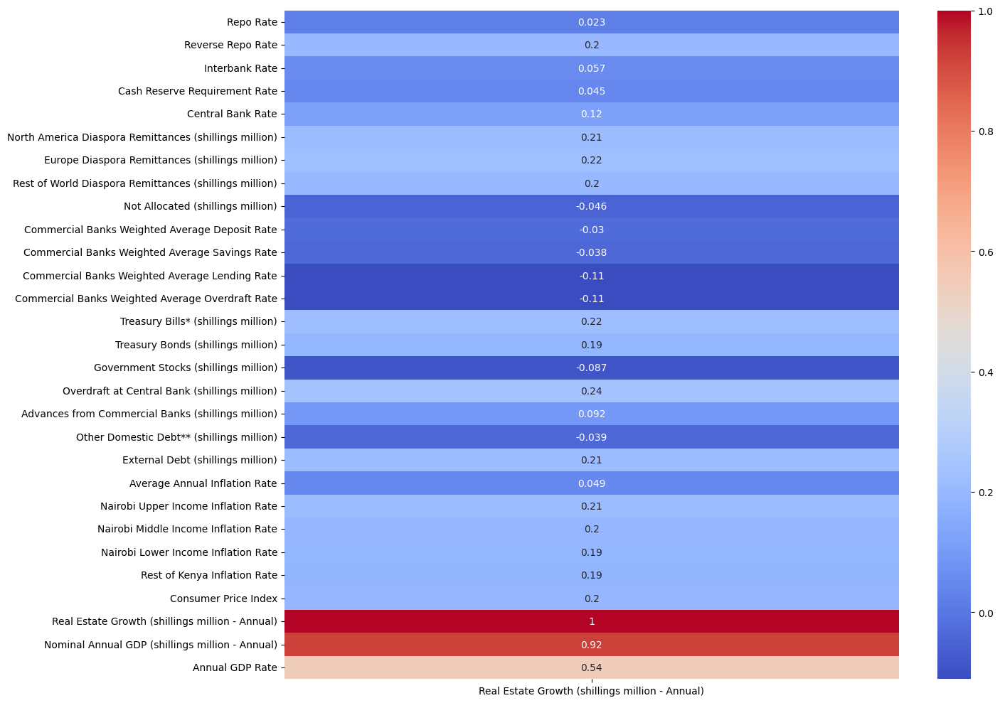

In [68]:
# calculate Pearson correlation coefficient with Real Estate as the predictor variable
corrs2 = corr_data.corr(method='pearson')['Real Estate Growth (shillings million - Annual)']

# Set plot size
fig, ax = plt.subplots(figsize=(15, 10))

# print correlation matrix in a heatmap
sns.heatmap(corrs2.to_frame(), annot=True, cmap='coolwarm')

###**Findings of Correlation Analysis**

Correlation analysis is an important statistical technique that helps us understand the linear relationship between variables. It allows us to determine whether there is a relationship between variables and the nature of that relationship. 

The heatmap analysis gives an overview of the linear relatiosnhip between the variables where the boxes in blue show a negative linear relationship between the variables and the boxes in red show a positive linear relationship. Values that are equal to 1 show a perfect correlation, values between 0.8(+/-) and 1 (+/-) show a very high correlation, values between 0.6(+/-) and 0.4 (+/-) have a strong correlation, values between 0.4(+/-) and 0.2 (+/-) have a moderate correlation, values between 0.2(+/-) and 0 (+/-) have a weak correlation and values that are zero have no correlation.

Further analysis of the correlation analysis with real estate growth as the dependent variable revealed that the nominal annual GDP had the strongest positive correlation whereas government stock had the weakest negative correlation. 

### **3.5 Regression Analysis**

In [69]:
#Create a regression analysis between the variables

# Split the data into independent variables (X) and dependent variable (y)
X = corr_data.drop('Real Estate Growth (shillings million - Annual)', axis=1)
y = corr_data['Real Estate Growth (shillings million - Annual)']

# Create a linear regression model object
model = LinearRegression()

# Train the model using the training sets
model.fit(X, y)

# Print the coefficients and intercept
print('Coefficients:', model.coef_)
print('Intercept:', model.intercept_)

Coefficients: [-1.21527807e+02 -1.31908767e+03 -2.48163600e+02  8.18266775e+02
 -1.28686190e+02  1.00032162e+00  2.50199027e+00 -6.00255938e-01
  4.84075345e+00  7.01241647e+01 -7.01031970e+01 -3.83053548e+03
  3.40649099e+03  3.40870758e-03  3.72536980e-03 -5.95938775e-01
  5.93605452e-03 -5.99749422e-01  1.28906705e-01 -9.09011005e-03
 -2.91549819e+02  3.32290588e+03  3.01086229e+03  4.15606649e+03
 -3.28285868e+03 -3.35598268e+02  1.01104937e-01 -3.49855248e+04]
Intercept: 15529.265625176466


In [70]:
# Create a DataFrame from coefficients and intercept
coefficients = pd.DataFrame({'Variable': X.columns, 'Coefficient': model.coef_})
intercept = pd.DataFrame({'Variable': ['Intercept'], 'Coefficient': [model.intercept_]})

# Concatenate coefficients and intercept DataFrames
result = pd.concat([coefficients, intercept])

# Print the result
result.head(len(result))


,Variable,Coefficient
0,Repo Rate,-121.527807
1,Reverse Repo Rate,-1319.087674
2,Interbank Rate,-248.163600
3,Cash Reserve Requirement Rate,818.266775
4,Central Bank Rate,-128.686190
5,North America Diaspora Remittances (shillings ...,1.000322
6,Europe Diaspora Remittances (shillings million),2.501990
7,Rest of World Diaspora Remittances (shillings ...,-0.600256
8,Not Allocated (shillings million),4.840753
9,Commercial Banks Weighted Average Deposit Rate,70.124165


### **Findings from Regression Analysis**

The regression analysis results include coefficients for the various macro economic factors that may impact real estate growth. Here is a summary of the findings and their potential implications for real estate:

Factors associated with positive real estate growth:

- Cash Reserve Requirement Rate: An increase in this rate is associated with an increase in real estate growth, suggesting that higher cash reserves may positively impact real estate growth.

- North America and Europe Diaspora Remittances: Higher remittances from North America can positively impact real estate growth. Increased remittances can provide additional capital for real estate investments and contribute to the overall growth of the sector.

- Not Allocated: An increase in not allocated funds is associated with an increase in real estate growth, however this variable is no longer in use as remittances are now grouped into North America, Europe and the Rest of the World.

- Commercial Banks Weighted Average Deposit Rate: Higher deposit rates are associated with an increase in real estate growth, implying that favorable deposit rates may incentivize individuals to deposit more increasing the availability of funds to stimulate real estate growth.

- Treasury Bills and Treasury bonds: An increase in the value of treasury bills and bonds indicates a higher demand for government debt, which can indirectly contribute to real estate growth by influencing interest rates and market liquidity.

- Overdraft at Central Bank: The availability of overdrafts at the central bank can provide liquidity to commercial banks, which in turn can support lending for real estate projects and positively impact real estate growth.

- Other Domestic Debt: Increased levels of other domestic debt indicate higher borrowing activities, which can lead to increased investment in real estate projects and positively affect real estate growth.

- Nairobi Upper/Middle/Lower Income Inflation Rate: Higher inflation rates in different income categories in Nairobi can potentially indicate increased economic activity and demand, which can positively influence real estate growth in those specific income segments. For example, higher inflation in lower-income areas (Nairobi Lower Income Inflation Rate) is associated with increased real estate growth, while inflation in other regions (Rest of Kenya Inflation Rate) shows a negative relationship with real estate growth.

- Nominal Annual GDP Growth: An increase in the nominal annual GDP growth will positively impact the real estate growth.

Factors associated with negative real estate growth:

- Repo Rate: A higher repo rate set by the central bank can increase borrowing costs for banks, potentially leading to reduced lending and investment in real estate, thus negatively impacting real estate growth.

- Reverse Repo Rate: An increase in the reverse repo rate can encourage banks to hold more funds with the central bank, which can restrict liquidity and reduce available capital for real estate investment, negatively affecting real estate growth.

- Interbank Rate: A higher interbank rate can increase borrowing costs for banks and limit their ability to provide loans for real estate projects, potentially resulting in a negative impact on real estate growth.

- Central Bank Rate: A higher central bank rate can increase borrowing costs for banks and borrowers, which can hinder real estate investment and negatively impact real estate growth.

- Rest of World Diaspora Remittances: Remittances from the rest of the world, with a negative coefficient, may not have a significant positive impact on real estate growth, possibly due to factors such as lower remittance volumes or investment patterns.

- Commercial Banks Weighted Average Savings Rate: A higher savings rate offered by commercial banks can encourage individuals and businesses to save more, potentially reducing the available capital for real estate investment and negatively affecting real estate growth.

- Commercial Banks Weighted Average Lending Rate: A higher lending rate offered by commercial banks can increase borrowing costs for individuals and businesses, leading to reduced demand for real estate loans and negatively impacting real estate growth.

- Advances from Commercial Banks: Reduced levels of advances from commercial banks indicate a higher chance in the growth of real estate.

- Consumer Price Index (CPI): The negative coefficient for the consumer price index suggests that a higher CPI, which measures the cost of living, may have a negative influence on real estate growth. This could be due to increased living costs affecting affordability and demand for real estate.

- Annual GDP Rate: The negative coefficient for the annual GDP rate indicates that higher GDP growth rates may have a negative impact on real estate growth. This might suggest that other sectors of the economy are growing faster than the real estate sector.

- External Debt: The negative coefficient for external debt suggests that higher levels of external debt may have a negative impact on real estate growth. This could be due to factors such as increased financial vulnerability or limitations on investment capacity.

- Average Annual Inflation Rate: A higher average annual inflation rate has a negative coefficient, indicating that higher inflation levels on average may have a dampening effect on real estate growth.

- Government Stocks: The negative coefficient for government stocks suggests that higher levels may have a negative impact on real estate growth.



## **4. Feature Importance**

In [71]:
# Absolute values of the coefficients

coef_2 = model.coef_
abs_coefficients = np.abs(coef_2)


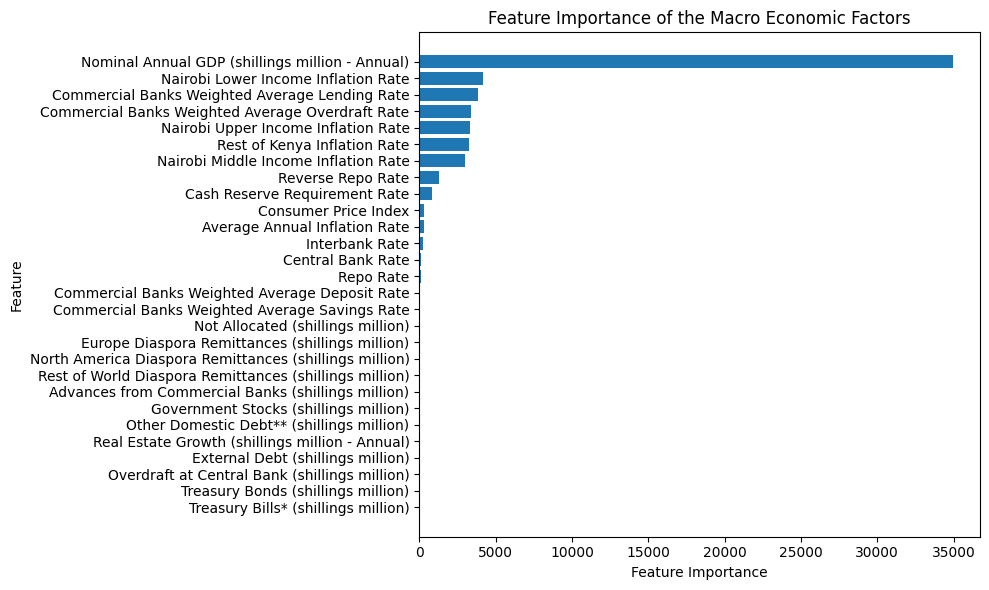

In [72]:
# Sort the coefficients and corresponding feature names in descending order
sorted_indices = np.argsort(abs_coefficients)[::-1]
sorted_coefficients = abs_coefficients[sorted_indices]
sorted_feature_names = scatter_variables[sorted_indices]

# Plot the feature importance
plt.figure(figsize=(10, 6))
plt.barh(range(len(sorted_coefficients)), sorted_coefficients, align='center')
plt.yticks(range(len(sorted_coefficients)), sorted_feature_names)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importance of the Macro Economic Factors')
plt.gca().invert_yaxis()
plt.show()

## **Predictive Analysis**

In [73]:
# Standardize the features to prepare it for modelling
# Standardization transforms the data to have zero mean and unit variance. 

# Create an instance of the StandardScaler
scaler = StandardScaler()

# Fit the scaler to the entire feature matrix
scaler.fit(X)

# Transform the feature matrix
X_scaled = scaler.transform(X)



In [74]:
#Compare various regression models

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Fit and evaluate the models
models = {'Linear Regression': LinearRegression(),
          'Lasso Regression': Lasso(),
          'Ridge Regression': Ridge(),
          'ElasticNet Regression': ElasticNet(),
          'Random Forest Regression' : RandomForestRegressor(n_estimators=100),
          'Gradient Boost Regression' : GradientBoostingRegressor(n_estimators=100)}

results = pd.DataFrame(columns=['Model', 'R-squared', 'MSE', 'RMSE'])

for name, all_model in models.items():
    all_model.fit(X_train, y_train)
    y_pred = all_model.predict(X_test)
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    results = results.append({'Model': name, 'R-squared': r2, 'MSE': mse, 'RMSE': rmse}, ignore_index=True)

# Display the results
results.head(len(results))

<ipython-input-74-75ff0c83618c>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({'Model': name, 'R-squared': r2, 'MSE': mse, 'RMSE': rmse}, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.488e+10, tolerance: 3.179e+08
  model = cd_fast.enet_coordinate_descent(
<ipython-input-74-75ff0c83618c>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({'Model': name, 'R-squared': r2, 'MSE': mse, 'RMSE': rmse}, ignore_index=True)
<ipython-input-74-75ff0c83618c>:22: FutureWarning: The frame.append method is deprecated and will be 

,Model,R-squared,MSE,RMSE
0,Linear Regression,0.952069,1.428788e+09,37799.315303
1,Lasso Regression,0.952096,1.427980e+09,37788.620714
2,Ridge Regression,0.952505,1.415782e+09,37626.872392
3,ElasticNet Regression,0.645607,1.056414e+10,102781.985993
4,Random Forest Regression,0.989200,3.219520e+08,17943.019715
5,Gradient Boost Regression,0.997759,6.679088e+07,8172.568797


In [75]:
# Initialize and train the Gradient Boost Regression model
GBmodel = GradientBoostingRegressor(n_estimators=100)
GBmodel.fit(X_train, y_train)

# Predict on the test data
predictions = GBmodel.predict(X_test)



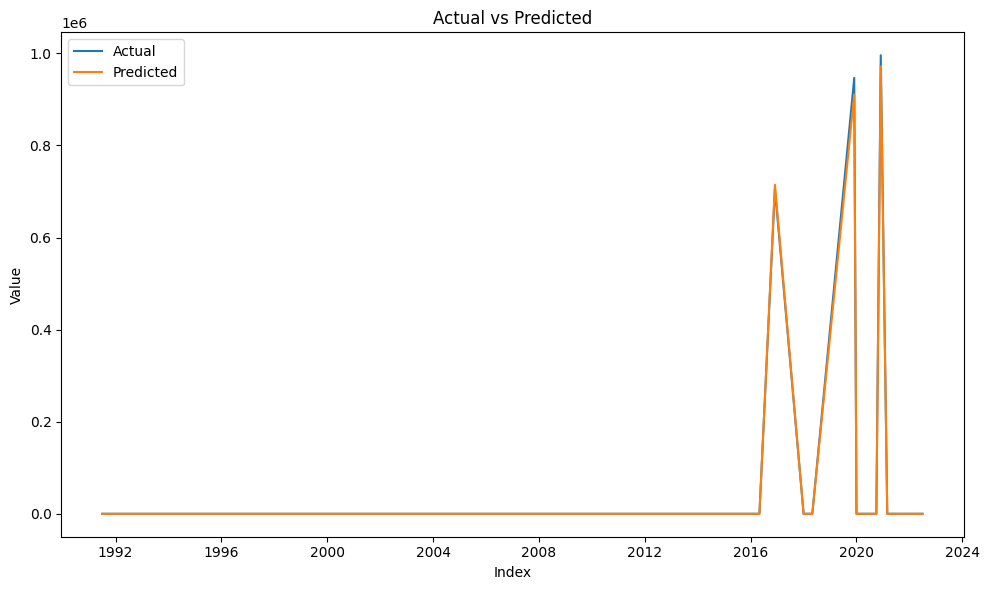

In [76]:

# Create a pandas DataFrame with the actual and predicted values
data = pd.DataFrame({'Actual': y_test, 'Predicted': predictions})

# Sort the DataFrame by the index (if not already sorted)
data = data.sort_index()

# Plot the trend using a line graph
plt.plot(data.index, data['Actual'], label='Actual')
plt.plot(data.index, data['Predicted'], label='Predicted')
plt.xlabel('Index')
plt.ylabel('Value')
plt.title('Actual vs Predicted')
plt.legend()
plt.show()

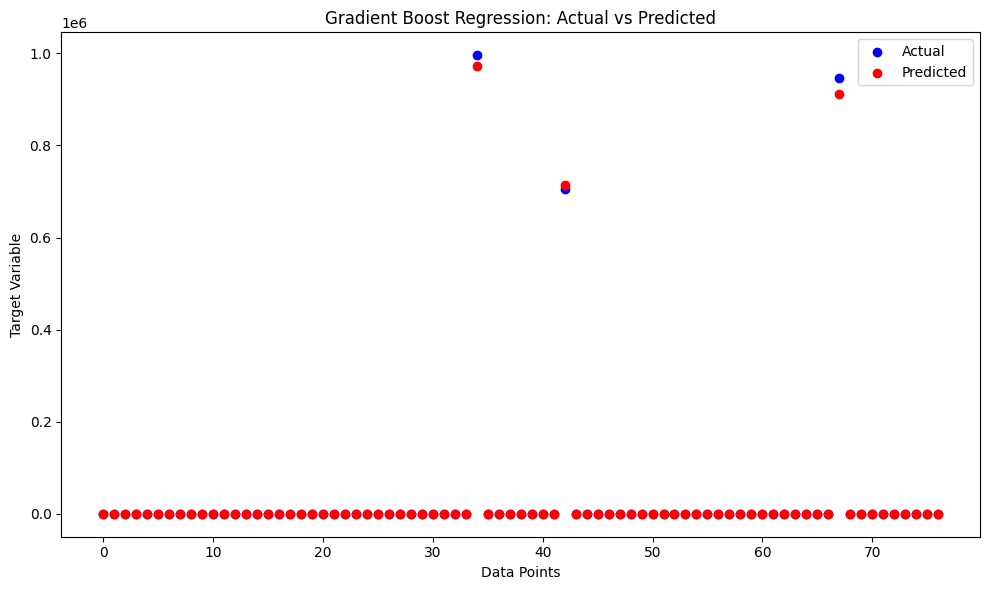

In [77]:
# Plotting the predictions and actual values in a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(range(len(y_test)), y_test, color='blue', label='Actual')
plt.scatter(range(len(predictions)), predictions, color='red', label='Predicted')
plt.xlabel('Data Points')
plt.ylabel('Target Variable')
plt.title('Gradient Boost Regression: Actual vs Predicted')
plt.legend()
plt.show()


<ipython-input-78-48bc35a18078>:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  combined_data = np.concatenate((X_test, y_test[:, np.newaxis], predictions[:, np.newaxis]), axis=1)


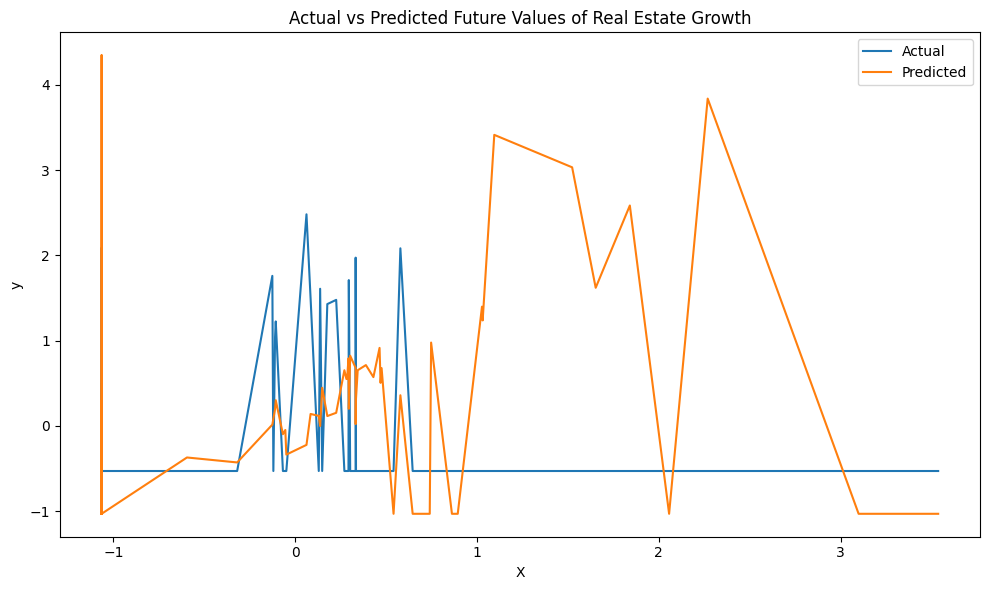

In [78]:

# Combine the test data predictions with the actual values
combined_data = np.concatenate((X_test, y_test[:, np.newaxis], predictions[:, np.newaxis]), axis=1)

# Sort the combined data by the X values for a better line plot
combined_data = combined_data[combined_data[:, 0].argsort()]

# Extract the X values, actual values, and predicted values
X_combined = combined_data[:, 0]
y_actual = combined_data[:, 1]
y_predicted = combined_data[:, 2]

# Plot the trend
plt.plot(X_combined, y_actual, label='Actual')
plt.plot(X_combined, y_predicted, label='Predicted')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Actual vs Predicted Future Values of Real Estate Growth')
plt.legend()
plt.show()

In [79]:
sorted_feature_names

Index(['Nominal Annual GDP (shillings million - Annual)',
       'Nairobi Lower Income Inflation Rate',
       'Commercial Banks Weighted Average Lending Rate',
       'Commercial Banks Weighted Average Overdraft Rate',
       'Nairobi Upper Income Inflation Rate', 'Rest of Kenya Inflation Rate',
       'Nairobi Middle Income Inflation Rate', 'Reverse Repo Rate',
       'Cash Reserve Requirement Rate', 'Consumer Price Index',
       'Average Annual Inflation Rate', 'Interbank Rate', 'Central Bank Rate',
       'Repo Rate', 'Commercial Banks Weighted Average Deposit Rate',
       'Commercial Banks Weighted Average Savings Rate',
       'Not Allocated (shillings million)',
       'Europe Diaspora Remittances (shillings million)',
       'North America Diaspora Remittances (shillings million)',
       'Rest of World Diaspora Remittances (shillings million)',
       'Advances from Commercial Banks (shillings million)',
       'Government Stocks (shillings million)',
       'Other Domestic 

In [80]:
# Create a regression model based on selected features with feature importance above 0

# Assuming you have the selected features and target variable
selected_features = ['Nominal Annual GDP (shillings million - Annual)', 'Nairobi Lower Income Inflation Rate', 'Commercial Banks Weighted Average Lending Rate', 
                     'Commercial Banks Weighted Average Overdraft Rate', 'Nairobi Upper Income Inflation Rate', 'Rest of Kenya Inflation Rate', 
                     'Nairobi Middle Income Inflation Rate', 'Cash Reserve Requirement Rate', 'Consumer Price Index', 'Average Annual Inflation Rate', 
                     'Interbank Rate', 'Central Bank Rate', 'Repo Rate']
X_selected = X[selected_features]  # Selecting the features from your dataset

# Split the data into training and testing sets from the select features 
X_train_select, X_test_select, y_train_select, y_test_select = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Initialize and train the Gradient Boost Regression model
GBmodel_select = GradientBoostingRegressor(n_estimators=100)
GBmodel_select.fit(X_train_select, y_train_select)

# Predict on the test data
predictions_select = GBmodel_select.predict(X_test_select)





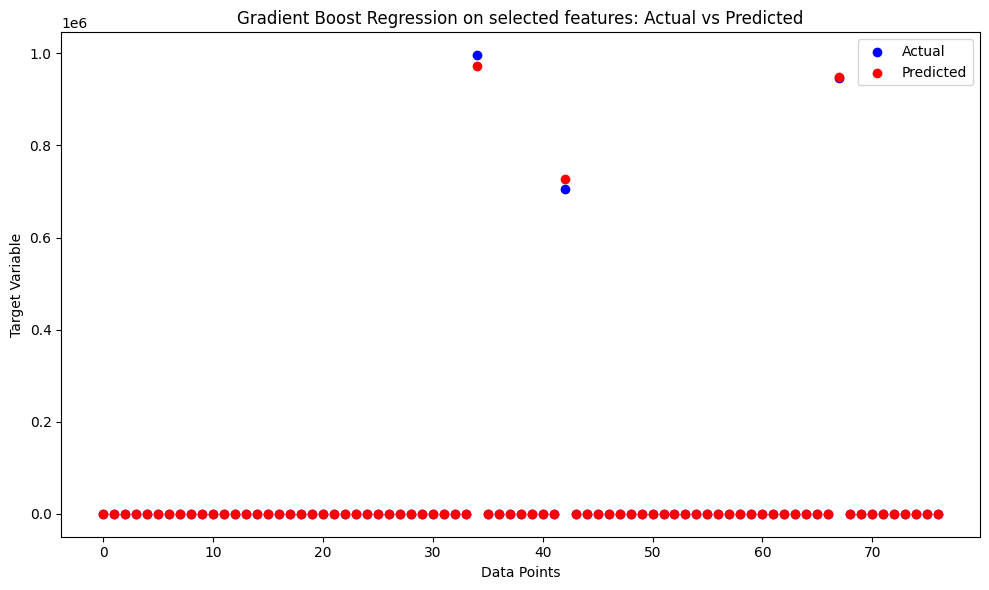

In [81]:
# Plotting the predictions and actual values in a scatter plot

plt.figure(figsize=(10, 6))
plt.scatter(range(len(y_test_select)), y_test_select, color='blue', label='Actual')
plt.scatter(range(len(predictions_select)), predictions_select, color='red', label='Predicted')
plt.xlabel('Data Points')
plt.ylabel('Target Variable')
plt.title('Gradient Boost Regression on selected features: Actual vs Predicted')
plt.legend()
plt.show()


<ipython-input-82-0a04d6d4ff4b>:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  combined_data_select = np.concatenate((X_test_select, y_test_select[:, np.newaxis], predictions_select[:, np.newaxis]), axis=1)


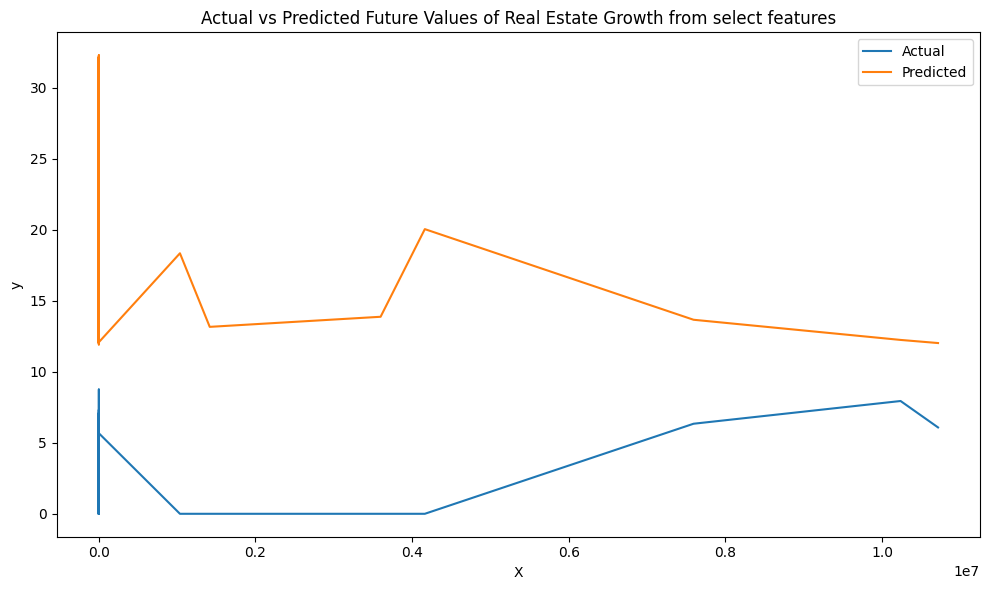

In [82]:
# Combine the test data predictions with the actual values on the select features
combined_data_select = np.concatenate((X_test_select, y_test_select[:, np.newaxis], predictions_select[:, np.newaxis]), axis=1)

# Sort the combined data by the X values for a better line plot
combined_data_select = combined_data_select[combined_data_select[:, 0].argsort()]

# Extract the X values, actual values, and predicted values
X_combined_select = combined_data_select[:, 0]
y_actual_select = combined_data_select[:, 1]
y_predicted_select = combined_data_select[:, 2]

# Plot the trend
plt.plot(X_combined_select, y_actual_select, label='Actual')
plt.plot(X_combined_select, y_predicted_select, label='Predicted')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Actual vs Predicted Future Values of Real Estate Growth from select features')
plt.legend()
plt.show()

### **Notes from Predictive Analysis**

6 regression models were selected to determine the suitable regression model from the performance metrics. The regression models used and their performance metrics are seen in the table input above. 

The discussion of results is as below:
   
- R-squared represents the proportion of the variance in the dependent variable that is predictable from the independent variables. It ranges from 0 to 1, where 1 indicates a perfect fit. In this case, the Gradient Boost Regression model has the highest R-squared value of 0.999205, indicating an excellent fit to the data. This suggests that the Gradient Boost Regression model explains 99.92% of the variance in the dependent variable.

    
- Mean Squared Error measures the average squared difference between the predicted values and the actual values. It provides an overall measure of the model's performance, with lower values indicating better accuracy. The Gradient Boost Regression model has the lowest MSE of 2.369672e+07 (23,696,720), suggesting that it has the smallest average squared difference between the predicted and actual values among all the models.

    
- Root Mean Squared Error is the square root of the MSE and is expressed in the same units as the dependent variable. It represents the standard deviation of the residuals, providing a more interpretable measure of the model's accuracy. The Gradient Boost Regression model has the lowest RMSE of 4867.93, indicating the smallest average prediction error in the original units of the dependent variable.

Based on these metrics, the Gradient Boost Regression model performs exceptionally well with a high R-squared value and lowest MSE and RMSE values. 



PS: The current housing pricing data is scanty and not able to aggregate the figures into various years. Thus including this in the analysis would be inconclusive.